# Import dependencies

In [1]:
!pip install keras

You are using pip version 9.0.1, however version 9.0.3 is available.
You should consider upgrading via the 'pip install --upgrade pip' command.


In [2]:
!pip install cython

You are using pip version 9.0.1, however version 9.0.3 is available.
You should consider upgrading via the 'pip install --upgrade pip' command.


In [3]:
import sys
sys.path.append('Mask_RCNN')

In [4]:
import os
import sys
import random
import math
import re
import time

import tensorflow as tf
config = tf.ConfigProto()
config.gpu_options.allow_growth = True
sess = tf.InteractiveSession(config=config)
#sess = tf.Session(config=config)

from keras import backend as K
K.set_session(sess)

import numpy as np
import pandas as pd
import matplotlib
import matplotlib.pyplot as plt
import csv
import imageio
import skimage
from config import Config
from skimage.morphology import label
from skimage.feature import canny
from skimage import exposure
from keras.callbacks import Callback
from skimage.morphology import binary_closing, binary_opening, disk, binary_dilation
from scipy.ndimage.morphology import binary_fill_holes
from sklearn.externals import joblib
from skimage.transform import PiecewiseAffineTransform, warp
from skimage.morphology import watershed
from skimage.filters import sobel
from preparation import vgg_feature_extractor

import gc; gc.enable()
import utils
import model as modellib
import visualize
from model import log

/usr/local/lib/python3.5/dist-packages/h5py/__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters
Using TensorFlow backend.


Let's download the mask_rcnn trained on COCO dataset to initialize the model.

In [5]:
pd.options.display.max_rows=100

# Root directory of the project
ROOT_DIR = os.getcwd()

# Directory to save logs and trained model
MODEL_DIR = os.path.join(ROOT_DIR, "logs")

# Local path to trained weights file
COCO_MODEL_PATH = os.path.join(ROOT_DIR, "mask_rcnn_coco.h5")
# Download COCO trained weights from Releases if needed
if not os.path.exists(COCO_MODEL_PATH):
    utils.download_trained_weights(COCO_MODEL_PATH)

We will now define the monitor that will help keep track on the training process.
With this you will be able to see your charts in the `charts` tab

Now we will load the metadata and divide them in train and valid splits

In [6]:
TRAIN_PATH = '../stage1_train'
TEST_PATH = '../stage1_test'
META_DATA_PATH = '../stage1_metadata.csv'

In [7]:
if not os.path.exists(META_DATA_PATH):
    print('Generating stage1_metadata.csv')
    
    stage1_metadata = pd.DataFrame()
    
    train_image_ids = os.listdir(TRAIN_PATH) # ImageId
    train_is_train = [1] * len(train_image_ids)
    train_file_path = [TRAIN_PATH + '/' + p + '/images/' + p + '.png' for p in train_image_ids]
    
    test_image_ids = os.listdir(TEST_PATH) # ImageId
    test_is_train = [0] * len(test_image_ids)
    test_file_path = [TEST_PATH + '/' + p + '/images/' + p + '.png' for p in test_image_ids]
    
    stage1_metadata['ImageId'] = np.concatenate([train_image_ids, test_image_ids], axis=0)
    stage1_metadata['is_train'] = np.concatenate([train_is_train, test_is_train], axis=0)
    stage1_metadata['file_path_image'] = np.concatenate([train_file_path, test_file_path], axis=0)
    
    ve = vgg_feature_extractor(n_clusters=10)
    train_vgg_features_clusters = ve.get_vgg_clusters(stage1_metadata[stage1_metadata.is_train == 1].reset_index(drop=True), is_train=True)
    test_vgg_features_clusters =ve.get_vgg_clusters(stage1_metadata[stage1_metadata.is_train == 0].reset_index(drop=True), is_train=False)
    
    stage1_metadata['vgg_features_clusters'] = np.concatenate([train_vgg_features_clusters, test_vgg_features_clusters], axis=0)
    
    stage1_metadata.to_csv(META_DATA_PATH, index=False)
    meta = stage1_metadata
    
    del vgg_feature_extractor; gc.collect()
else:
    meta = pd.read_csv(META_DATA_PATH)
    

meta.head(100)

,ImageId,is_train,file_path_image,vgg_features_clusters
0,ef6634efb46567d87b811be786b18c4cd0e2cda23d79b6...,1,../stage1_train/ef6634efb46567d87b811be786b18c...,0
1,351771edfc5db5665ded8aa4940257276b6526663c76e3...,1,../stage1_train/351771edfc5db5665ded8aa4940257...,5
2,785555c0cbb49dad835635217085287a8cc61c27d26f0e...,1,../stage1_train/785555c0cbb49dad83563521708528...,6
3,7ba20aa731cc21af74a8d940254176cbad1bdc44f240b5...,1,../stage1_train/7ba20aa731cc21af74a8d940254176...,7
4,43cf6b2ec0b0745ac2b87b4d8780f62e9050d3f5d50a1f...,1,../stage1_train/43cf6b2ec0b0745ac2b87b4d8780f6...,8
5,0b2e702f90aee4fff2bc6e4326308d50cf04701082e718...,1,../stage1_train/0b2e702f90aee4fff2bc6e4326308d...,6
6,61dc249314d7b965eb4561ec739eab9b0f60af55c97b25...,1,../stage1_train/61dc249314d7b965eb4561ec739eab...,5
7,28d33efef218392e79e385906deb88055d94b65ad217de...,1,../stage1_train/28d33efef218392e79e385906deb88...,2
8,4596961c789d3b41916492918797724fe75128239fefc5...,1,../stage1_train/4596961c789d3b4191649291879772...,5
9,1ec74a26e772966df764e063f1391109a60d803cff9d15...,1,../stage1_train/1ec74a26e772966df764e063f13911...,1


In [8]:
def train_valid_split(meta_train, meta_test, validation_size, valid_category_ids=None):
    meta_train_split, meta_valid_split = split_on_column(meta_train, meta_test,
                                                         column='vgg_features_clusters',
                                                         test_size=validation_size,
                                                         random_state=1234,
                                                         valid_category_ids=valid_category_ids
                                                         )
    return meta_train_split, meta_valid_split


def split_on_column(meta_train, meta_test, column, test_size, random_state=1, valid_category_ids=None):
    if valid_category_ids is None:
        '''
        categories = meta[column].unique()
        np.random.seed(random_state)
        valid_category_ids = np.random.choice(categories,
                                              int(test_size * len(categories)))
        '''
        
        categories = meta_train[column].unique()
        
        train = []
        valid = []
        
        for c in categories:
            print(meta_test[meta_test[column]==c].shape[0], meta_train[meta_train[column]==c].shape[0])
            test_size = meta_test[meta_test[column]==c].shape[0]/meta_train[meta_train[column]==c].shape[0]
            print('Column ', c, ' test size=', test_size)
            
            val = meta_train[meta_train[column]==c].sample(frac=test_size, random_state=random_state)
            tr = meta_train[meta_train[column]==c][~meta_train[meta_train[column]==c].index.isin(val.index)]
            
            train.append(tr)
            valid.append(val)
                
        train = pd.concat(train, axis=0).reset_index(drop=True)
        valid = pd.concat(valid, axis=0).reset_index(drop=True)
    else:    
        meta = meta_train
        valid = meta[meta[column].isin(valid_category_ids)].sample(frac=1, random_state=random_state)
        train = meta[~(meta[column].isin(valid_category_ids))].sample(frac=1, random_state=random_state)
    
    return train, valid


meta_train = meta[meta['is_train']==1]
meta_test = meta[meta['is_train']==0]
meta_train, meta_valid = train_valid_split( meta_train, meta_test, 0.2, None)
print(meta_train.shape, meta_valid.shape)

4 61
Column  0  test size= 0.06557377049180328
11 66
Column  5  test size= 0.16666666666666666
25 135
Column  6  test size= 0.18518518518518517
4 86
Column  7  test size= 0.046511627906976744
2 26
Column  8  test size= 0.07692307692307693
4 102
Column  2  test size= 0.0392156862745098
9 101
Column  1  test size= 0.0891089108910891
6 66
Column  3  test size= 0.09090909090909091
0 16
Column  4  test size= 0.0
0 5
Column  9  test size= 0.0
(599, 4) (65, 4)


# Mask-RCNN configuration
We will now define parameters for our mask-rcnn. 
Tweak them to get better results!

In [9]:
class DsbConfig(Config):

    # Give the configuration a recognizable name
    NAME = "dsb"
      
    LEARNING_RATE = 1e-2
    
    # If enabled, resizes instance masks to a smaller size to reduce
    # memory load. Recommended when using high-resolution image
    USE_MINI_MASK = True
    MINI_MASK_SHAPE = (56, 56)  # (height, width) of the mini-mask
    
    # Train on 1 GPU and 8 images per GPU. Batch size is GPUs * images/GPU.
    GPU_COUNT = 1
    IMAGES_PER_GPU = 2
    # Total number of steps (batches of samples) to yield from generator before declaring one epoch finished and starting the next epoch.
    # typically be equal to the number of samples of your dataset divided by the batch size
    STEPS_PER_EPOCH = 300
    VALIDATION_STEPS = 70

    # Number of classes (including background)
    NUM_CLASSES = 1 + 1  # background + nucleis
    IMAGE_MIN_DIM = 512
    IMAGE_MAX_DIM = 512
    IMAGE_PADDING = True  # currently, the False option is not supported
    RPN_ANCHOR_SCALES = (8, 16, 32, 64, 128)  # anchor side in pixels, maybe add a 256?
    # The strides of each layer of the FPN Pyramid. These values
    # are based on a Resnet101 backbone.
    BACKBONE_STRIDES = [4, 8, 16, 32, 64]
    # How many anchors per image to use for RPN training
    RPN_TRAIN_ANCHORS_PER_IMAGE = 320 #300
    
    # ROIs kept after non-maximum supression (training and inference)
    POST_NMS_ROIS_TRAINING = 2000
    POST_NMS_ROIS_INFERENCE = 2000
    POOL_SIZE = 7
    MASK_POOL_SIZE = 14 # 14
    MASK_SHAPE = [28, 28] # 28
    TRAIN_ROIS_PER_IMAGE = 512
    RPN_DETECTION_MIN_CONFIDENCE = .6
    RPN_NMS_THRESHOLD = 0.7 #0.7
    MAX_GT_INSTANCES = 256
    DETECTION_MAX_INSTANCES = 400 
    # Minimum probability value to accept a detected instance
    # ROIs below this threshold are skipped
    DETECTION_MIN_CONFIDENCE = 0.7 # may be smaller?
    # Non-maximum suppression threshold for detection
    DETECTION_NMS_THRESHOLD = 0.3 # 0.3
    
    # DETECTION_MAX_INSTANCES=400, DETECTION_MIN_CONFIDENCE=.7 => Val loss: .21xx, LB: .424
    # DETECTION_MAX_INSTANCES=450, DETECTION_MIN_CONFIDENCE=.65 => Val loss: .3, LB: .438
    # DETECTION_MAX_INSTANCES=, DETECTION_MIN_CONFIDENCE= => Val loss: ., LB: .
    
    '''
    0324 note: 
        RPN_NMS_THRESHOLD .7 -> .6 to generate more proposals at training,
        DETECTION_MAX_INSTANCES 400 -> 450
        DETECTION_MIN_CONFIDENCE .7
        BACKBONE_STRIDES add `2` ..?
    '''
    
    MEAN_PIXEL = np.array([0.,0.,0.])
    
    # Weight decay regularization
    WEIGHT_DECAY = 0.0001
    
    # Min Box Size
    MIN_BOX_SIZE = 25./(512.**2.) # (25/512**2) (delete objects smaller than 5*5 pixels)
    BORDER_RATIO = 4. / 512. # smaller than 4 pixels width\height at the border
    BORDER_MIN_BOX_SIZE = 16./(512.**2.)
    
config = DsbConfig()

In [10]:
config.DETECTION_MIN_CONFIDENCE

0.7

# Dataset definition

We need to define our datasets for the data science bowl competition

In [11]:
class DsbDataset(utils.Dataset):

    def load_dataset(self, ids, train_mode=True):
        self.add_class("dsb", 1, "nuclei")
        if train_mode:
            directory = dsb_dir
        else:
            directory = test_dir
        for i, id in enumerate(ids):
            image_dir = os.path.join(directory, id)
            self.add_image("dsb", image_id=i, path=image_dir)
            

    def load_image(self, image_id, non_zero=None):
        info = self.image_info[image_id]
        path = info['path']
        image_name = os.listdir(os.path.join(path, 'images'))
        image_path = os.path.join(path, 'images', image_name[0])
        image = imageio.imread(image_path)
        if image.shape[2] != 3:
            image = image[:,:,:3]
        image = self.preprocess(image)
        image = image.astype('float32')
        return image

    def image_reference(self, image_id):
        info = self.image_info[image_id]
        if info["source"] == "shapes":
            return info["shapes"]
        else:
            super(self.__class__).image_reference(self, image_id)

    def load_mask(self, image_id):
        info = self.image_info[image_id]
        path = info['path']
        mask_dir = os.path.join(path, 'masks')
        mask_names = os.listdir(mask_dir)
        count = len(mask_names)
        mask = []
        for i, el in enumerate(mask_names):
            msk_path = os.path.join(mask_dir, el)
            msk = imageio.imread(msk_path)
            if np.sum(msk) == 0:
                print('invalid mask')
                continue
            msk = msk.astype('float32')/255.
            
            if len(msk.shape) > 2:
                msk = np.sum(msk, axis=2)
                
            mask.append(msk)
            
        try:
            mask = np.array(mask)
        except:
            for i, m in enumerate(mask):
                if len(m.shape) > 2:
                    print(mask_names[i])
                    
        mask[mask > 0.] = 1.
        mask = np.transpose(mask, (1,2,0))
        occlusion = np.logical_not(mask[:, :, -1]).astype(np.uint8)
        count = mask.shape[2]
        for i in range(count-2, -1, -1):
            mask[:, :, i] = mask[:, :, i] * occlusion
            occlusion = np.logical_and(occlusion, np.logical_not(mask[:, :, i]))
        class_ids = [self.class_names.index('nuclei') for s in range(count)]
        class_ids = np.asarray(class_ids)
        
        return mask, class_ids.astype(np.int32)
    
    def preprocess(self, img):
        gray = skimage.color.rgb2gray(img.astype('uint8'))
        img = skimage.color.gray2rgb(gray)
        img *= 255.
        return img

In [12]:
dsb_dir = TRAIN_PATH
train_ids = meta_train.ImageId.values
val_ids = meta_valid.ImageId.values
test_dir = TEST_PATH
test_ids = os.listdir(test_dir)

In [13]:
# Training dataset
dataset_train = DsbDataset()
dataset_train.load_dataset(train_ids)
dataset_train.prepare()

# Validation dataset
dataset_val = DsbDataset()
dataset_val.load_dataset(val_ids)
dataset_val.prepare()

# Test dataset
dataset_test = DsbDataset()
dataset_test.load_dataset(test_ids, train_mode=False)
dataset_test.prepare()

Let's take a look at some images

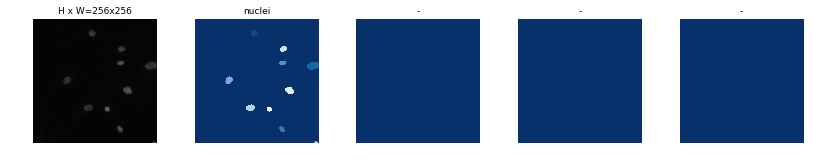

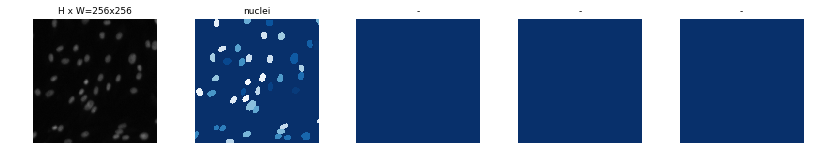

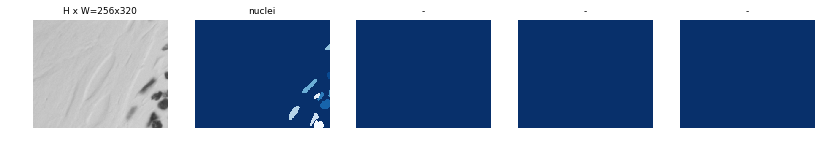

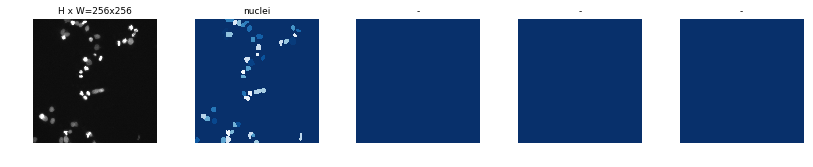

In [14]:
image_ids = np.random.choice(dataset_train.image_ids, 4)
for image_id in image_ids:
    image = dataset_train.load_image(image_id)
    mask, class_ids = dataset_train.load_mask(image_id)
    visualize.display_top_masks(image, mask, class_ids, dataset_train.class_names)

# Model Training

OK! 

I think we are ready to do some training!
We will instantiate the model and initialize it with COCO weights

In [15]:
model = modellib.MaskRCNN(mode="training", config=config,
                          model_dir=MODEL_DIR)

In [16]:
init_with = "coco"  # imagenet, coco, or last

if init_with == "imagenet":
    model.load_weights(model.get_imagenet_weights(), by_name=True)
elif init_with == "coco":
    # Load weights trained on MS COCO, but skip layers that
    # are different due to the different number of classes
    # See README for instructions to download the COCO weights
    model.load_weights(COCO_MODEL_PATH, by_name=True,
                       exclude=["mrcnn_class_logits", "mrcnn_bbox_fc", 
                                "mrcnn_bbox", "mrcnn_mask"])
elif init_with == "last":
    # Load the last model you trained and continue training
    model.load_weights(model.find_last()[1], by_name=True)

Let's train and investigate the learning curves for all the mask-rcnn losses in the `charts` and `channels`

In [17]:
model.train(dataset_train, dataset_val, 
                learning_rate=config.LEARNING_RATE,
                epochs=15, 
                layers="all", clbcks=[])


Starting at epoch 0. LR=0.01

Checkpoint Path: /data/khyeh/logs/dsb20180328T1109/mask_rcnn_dsb_{epoch:04d}.h5
Selecting layers to train
conv1                  (Conv2D)
bn_conv1               (BatchNorm)
res2a_branch2a         (Conv2D)
bn2a_branch2a          (BatchNorm)
res2a_branch2b         (Conv2D)
bn2a_branch2b          (BatchNorm)
res2a_branch2c         (Conv2D)
res2a_branch1          (Conv2D)
bn2a_branch2c          (BatchNorm)
bn2a_branch1           (BatchNorm)
res2b_branch2a         (Conv2D)
bn2b_branch2a          (BatchNorm)
res2b_branch2b         (Conv2D)
bn2b_branch2b          (BatchNorm)
res2b_branch2c         (Conv2D)
bn2b_branch2c          (BatchNorm)
res2c_branch2a         (Conv2D)
bn2c_branch2a          (BatchNorm)
res2c_branch2b         (Conv2D)
bn2c_branch2b          (BatchNorm)
res2c_branch2c         (Conv2D)
bn2c_branch2c          (BatchNorm)
res3a_branch2a         (Conv2D)
bn3a_branch2a          (BatchNorm)
res3a_branch2b         (Conv2D)
bn3a_branch2b          (Bat

/usr/local/lib/python3.5/dist-packages/tensorflow/python/ops/gradients_impl.py:96: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "
/usr/local/lib/python3.5/dist-packages/keras/engine/training.py:2087: UserWarning: Using a generator with `use_multiprocessing=True` and multiple workers may duplicate your data. Please consider using the`keras.utils.Sequence class.
  UserWarning('Using a generator with `use_multiprocessing=True`'


Epoch 1/15


/usr/local/lib/python3.5/dist-packages/scipy/ndimage/interpolation.py:616: UserWarning: From scipy 0.13.0, the output shape of zoom() is calculated with round() instead of int() - for these inputs the size of the returned array has changed.
  "the returned array has changed.", UserWarning)
/usr/local/lib/python3.5/dist-packages/scipy/ndimage/interpolation.py:616: UserWarning: From scipy 0.13.0, the output shape of zoom() is calculated with round() instead of int() - for these inputs the size of the returned array has changed.
  "the returned array has changed.", UserWarning)



Epoch 00001: LearningRateScheduler reducing learning rate to 0.01.
300/300 [==============================] - 750s 3s/step - loss: 1.2674 - rpn_class_loss: 0.0795 - rpn_bbox_loss: 0.4978 - mrcnn_class_loss: 0.1656 - mrcnn_bbox_loss: 0.2573 - mrcnn_mask_loss: 0.2672 - val_loss: 0.8908 - val_rpn_class_loss: 0.0219 - val_rpn_bbox_loss: 0.3451 - val_mrcnn_class_loss: 0.1456 - val_mrcnn_bbox_loss: 0.1816 - val_mrcnn_mask_loss: 0.1965
Epoch 2/15

Epoch 00002: LearningRateScheduler reducing learning rate to 0.01.
300/300 [==============================] - 737s 2s/step - loss: 0.9302 - rpn_class_loss: 0.0352 - rpn_bbox_loss: 0.3214 - mrcnn_class_loss: 0.1529 - mrcnn_bbox_loss: 0.1755 - mrcnn_mask_loss: 0.2452 - val_loss: 0.8935 - val_rpn_class_loss: 0.0187 - val_rpn_bbox_loss: 0.3611 - val_mrcnn_class_loss: 0.1365 - val_mrcnn_bbox_loss: 0.1720 - val_mrcnn_mask_loss: 0.2053
Epoch 3/15

Epoch 00003: LearningRateScheduler reducing learning rate to 0.01.
300/300 [==============================] -

# Evaluate
I think we are ready to see how our model does on the validation!

In [40]:
class InferenceConfig(DsbConfig):
    GPU_COUNT = 1
    IMAGES_PER_GPU = 1
    # MEAN_PIXEL = np.array([56.02288505, 54.02376286, 54.26675248])
    
    
    DETECTION_MIN_CONFIDENCE = 0.9
    SNMS_METHOD = 2 # 0: normal greedy nms, 1: linear method 2: Gaussian method
    SNMS_SIGMA = 0.5

inference_config = InferenceConfig()

In [41]:
model = modellib.MaskRCNN(mode="inference", 
                          config=inference_config,
                          model_dir=MODEL_DIR)

# Get path to saved weights
# Either set a specific path or find last trained weights
#model_path = os.path.join(ROOT_DIR, "logs/dsb20180323T1422/mask_rcnn_dsb_0003.h5")
model_path = model.find_last()[1]

# Load trained weights (fill in path to trained weights here)
assert model_path != "", "Provide path to trained weights"
print("Loading weights from ", model_path)
model.load_weights(model_path, by_name=True)

Loading weights from  /data/khyeh/logs/dsb20180328T1109/mask_rcnn_dsb_0015.h5


In [42]:
def get_ax(rows=1, cols=1, size=8):
    """Return a Matplotlib Axes array to be used in
    all visualizations in the notebook. Provide a
    central point to control graph sizes.
    
    Change the default size attribute to control the size
    of rendered images
    """
    _, ax = plt.subplots(rows, cols, figsize=(size*cols, size*rows))
    return ax

original_image           shape: (512, 512, 3)         min:    0.00000  max:  250.00000
image_meta               shape: (10,)                 min:    0.00000  max:  512.00000
gt_class_id              shape: (65,)                 min:    1.00000  max:    1.00000
gt_bbox                  shape: (65, 4)               min:    0.00000  max:  512.00000
gt_mask                  shape: (512, 512, 65)        min:    0.00000  max:    1.00000


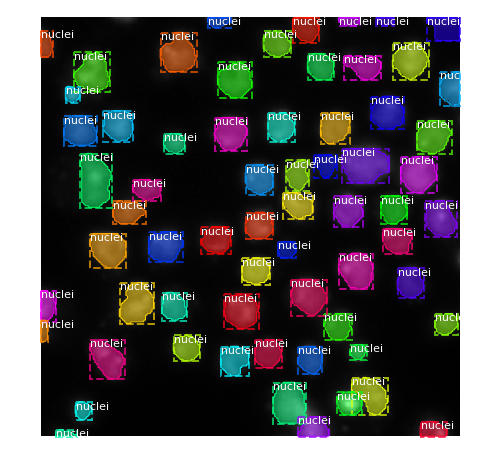

Processing 1 images
image                    shape: (512, 512, 3)         min:    0.00000  max:  250.00000
molded_images            shape: (1, 512, 512, 3)      min:    0.00000  max:  250.00000
image_metas              shape: (1, 10)               min:    0.00000  max:  512.00000


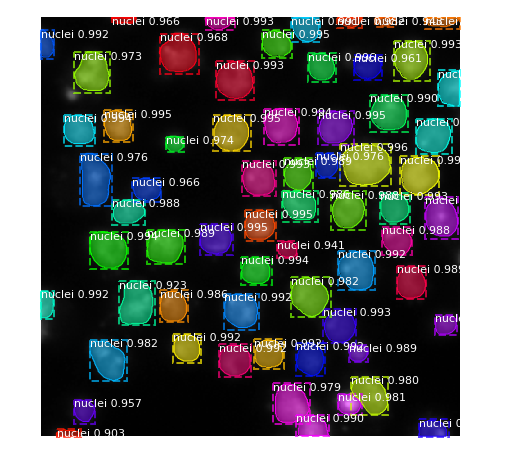

original_image           shape: (512, 512, 3)         min:    0.00000  max:  253.00000
image_meta               shape: (10,)                 min:    0.00000  max:  512.00000
gt_class_id              shape: (28,)                 min:    1.00000  max:    1.00000
gt_bbox                  shape: (28, 4)               min:    0.00000  max:  512.00000
gt_mask                  shape: (512, 512, 28)        min:    0.00000  max:    1.00000


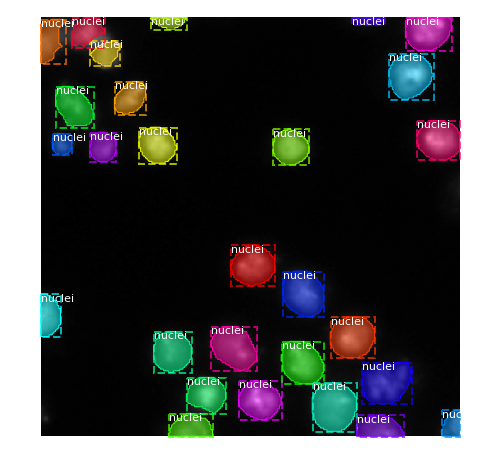

Processing 1 images
image                    shape: (512, 512, 3)         min:    0.00000  max:  253.00000
molded_images            shape: (1, 512, 512, 3)      min:    0.00000  max:  253.00000
image_metas              shape: (1, 10)               min:    0.00000  max:  512.00000


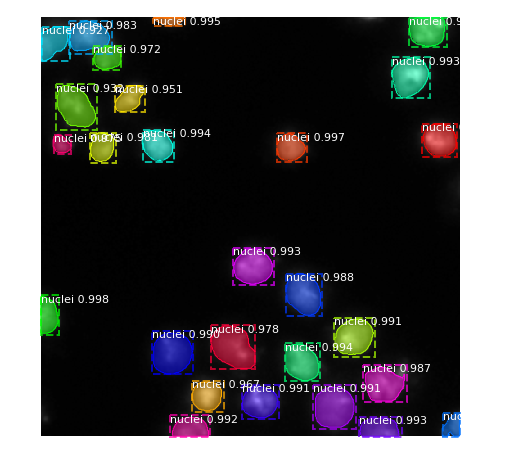

original_image           shape: (512, 512, 3)         min:    0.00000  max:  251.00000
image_meta               shape: (10,)                 min:    0.00000  max:  512.00000
gt_class_id              shape: (56,)                 min:    1.00000  max:    1.00000
gt_bbox                  shape: (56, 4)               min:    0.00000  max:  512.00000
gt_mask                  shape: (512, 512, 56)        min:    0.00000  max:    1.00000


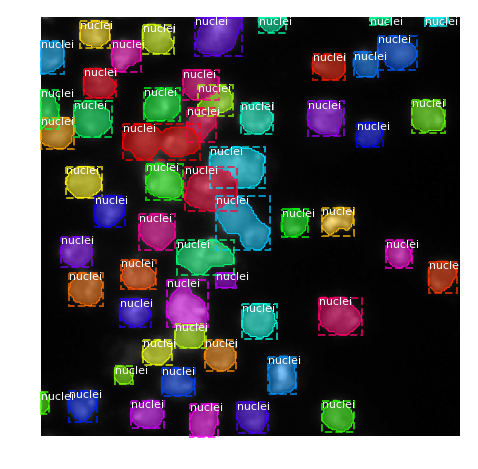

Processing 1 images
image                    shape: (512, 512, 3)         min:    0.00000  max:  251.00000
molded_images            shape: (1, 512, 512, 3)      min:    0.00000  max:  251.00000
image_metas              shape: (1, 10)               min:    0.00000  max:  512.00000


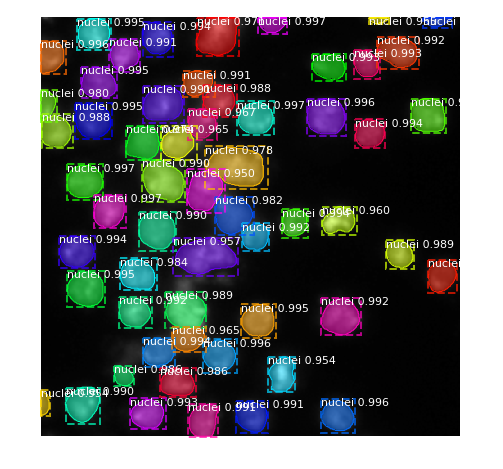

original_image           shape: (512, 512, 3)         min:    0.00000  max:  253.00000
image_meta               shape: (10,)                 min:    0.00000  max:  512.00000
gt_class_id              shape: (44,)                 min:    1.00000  max:    1.00000
gt_bbox                  shape: (44, 4)               min:    0.00000  max:  512.00000
gt_mask                  shape: (512, 512, 44)        min:    0.00000  max:    1.00000


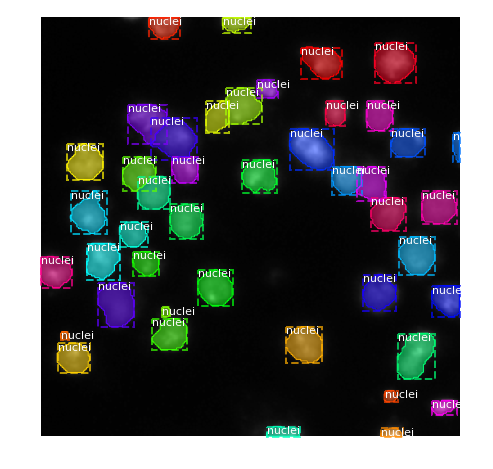

Processing 1 images
image                    shape: (512, 512, 3)         min:    0.00000  max:  253.00000
molded_images            shape: (1, 512, 512, 3)      min:    0.00000  max:  253.00000
image_metas              shape: (1, 10)               min:    0.00000  max:  512.00000


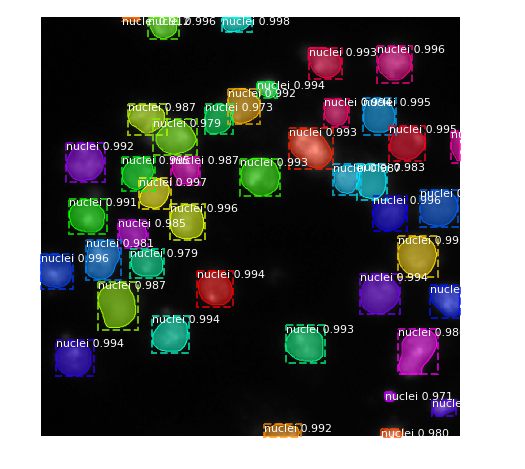

original_image           shape: (512, 512, 3)         min:    2.00000  max:  254.00000
image_meta               shape: (10,)                 min:    0.00000  max:  512.00000
gt_class_id              shape: (50,)                 min:    1.00000  max:    1.00000
gt_bbox                  shape: (50, 4)               min:    0.00000  max:  512.00000
gt_mask                  shape: (512, 512, 50)        min:    0.00000  max:    1.00000


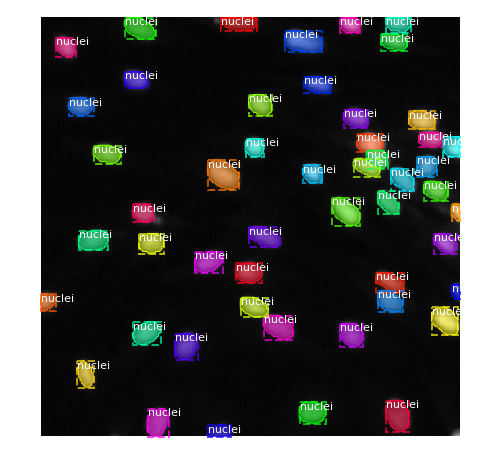

Processing 1 images
image                    shape: (512, 512, 3)         min:    2.00000  max:  254.00000
molded_images            shape: (1, 512, 512, 3)      min:    2.00000  max:  254.00000
image_metas              shape: (1, 10)               min:    0.00000  max:  512.00000


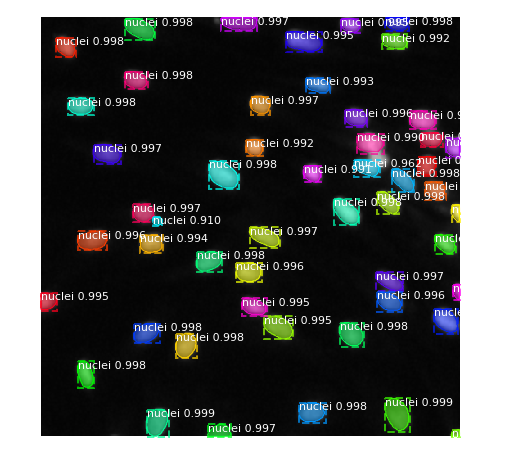

/usr/local/lib/python3.5/dist-packages/scipy/ndimage/interpolation.py:616: UserWarning: From scipy 0.13.0, the output shape of zoom() is calculated with round() instead of int() - for these inputs the size of the returned array has changed.
  "the returned array has changed.", UserWarning)


original_image           shape: (512, 512, 3)         min:    0.00000  max:  227.00000
image_meta               shape: (10,)                 min:    0.00000  max:  696.00000
gt_class_id              shape: (119,)                min:    1.00000  max:    1.00000
gt_bbox                  shape: (119, 4)              min:    0.00000  max:  512.00000
gt_mask                  shape: (512, 512, 119)       min:    0.00000  max:    1.00000


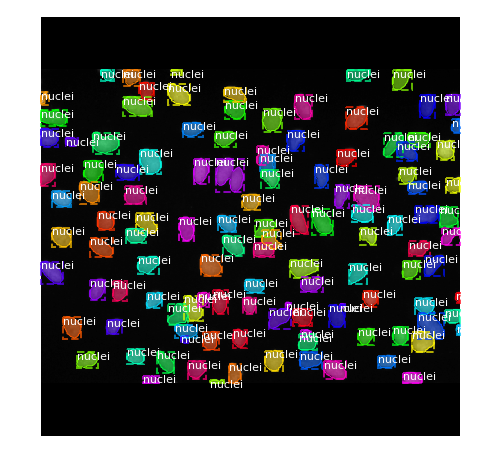

Processing 1 images
image                    shape: (512, 512, 3)         min:    0.00000  max:  227.00000
molded_images            shape: (1, 512, 512, 3)      min:    0.00000  max:  227.00000
image_metas              shape: (1, 10)               min:    0.00000  max:  512.00000


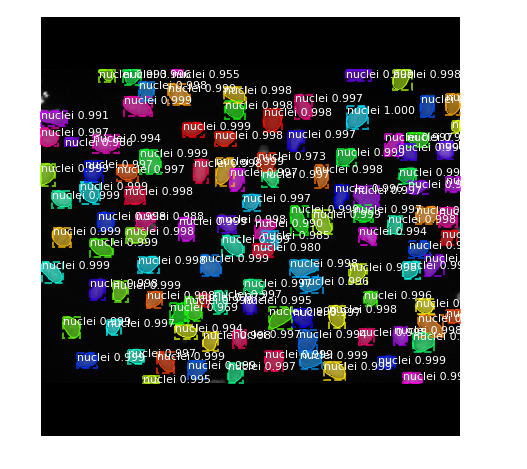

original_image           shape: (512, 512, 3)         min:    0.00000  max:  247.00000
image_meta               shape: (10,)                 min:    0.00000  max:  696.00000
gt_class_id              shape: (136,)                min:    1.00000  max:    1.00000
gt_bbox                  shape: (136, 4)              min:    0.00000  max:  512.00000
gt_mask                  shape: (512, 512, 136)       min:    0.00000  max:    1.00000


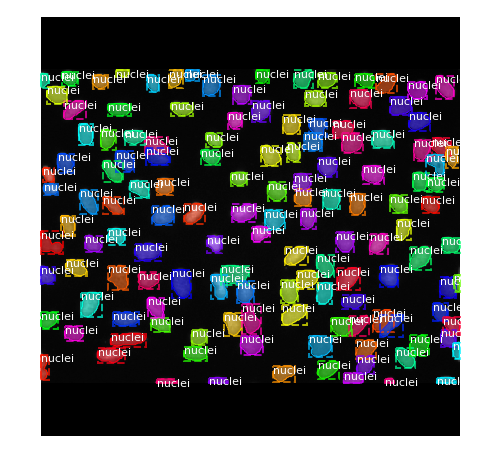

Processing 1 images
image                    shape: (512, 512, 3)         min:    0.00000  max:  247.00000
molded_images            shape: (1, 512, 512, 3)      min:    0.00000  max:  247.00000
image_metas              shape: (1, 10)               min:    0.00000  max:  512.00000


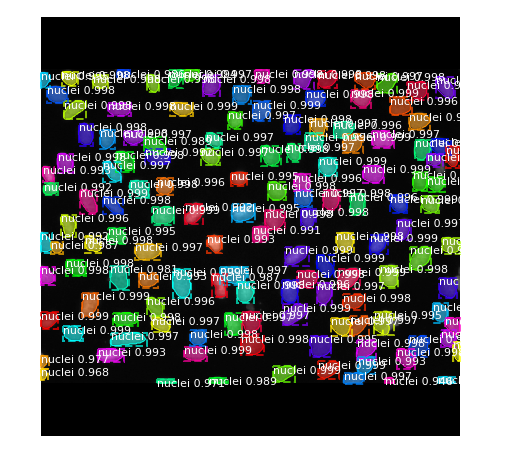

original_image           shape: (512, 512, 3)         min:    0.00000  max:  243.00000
image_meta               shape: (10,)                 min:    0.00000  max:  696.00000
gt_class_id              shape: (101,)                min:    1.00000  max:    1.00000
gt_bbox                  shape: (101, 4)              min:    0.00000  max:  512.00000
gt_mask                  shape: (512, 512, 101)       min:    0.00000  max:    1.00000


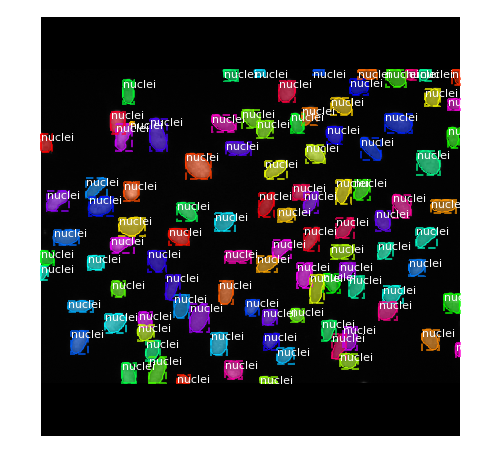

Processing 1 images
image                    shape: (512, 512, 3)         min:    0.00000  max:  243.00000
molded_images            shape: (1, 512, 512, 3)      min:    0.00000  max:  243.00000
image_metas              shape: (1, 10)               min:    0.00000  max:  512.00000


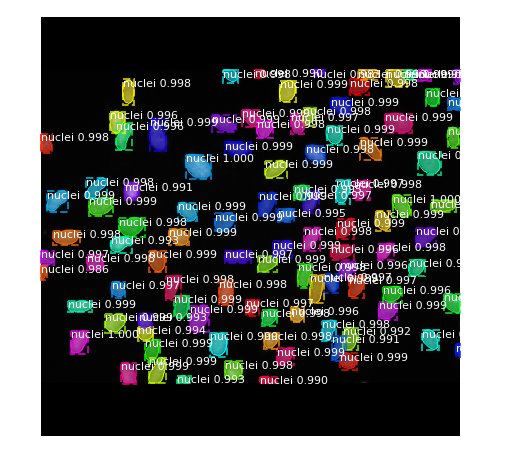

original_image           shape: (512, 512, 3)         min:    0.00000  max:  238.00000
image_meta               shape: (10,)                 min:    0.00000  max:  696.00000
gt_class_id              shape: (106,)                min:    1.00000  max:    1.00000
gt_bbox                  shape: (106, 4)              min:    0.00000  max:  512.00000
gt_mask                  shape: (512, 512, 106)       min:    0.00000  max:    1.00000


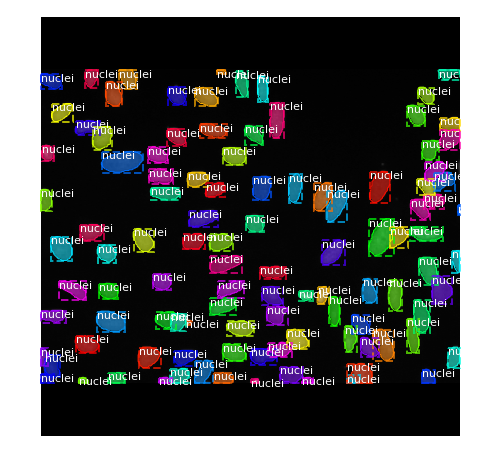

Processing 1 images
image                    shape: (512, 512, 3)         min:    0.00000  max:  238.00000
molded_images            shape: (1, 512, 512, 3)      min:    0.00000  max:  238.00000
image_metas              shape: (1, 10)               min:    0.00000  max:  512.00000


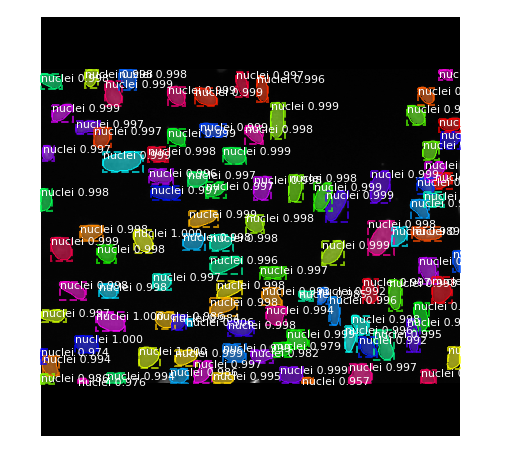

original_image           shape: (512, 512, 3)         min:    0.00000  max:  255.00000
image_meta               shape: (10,)                 min:    0.00000  max:  696.00000
gt_class_id              shape: (134,)                min:    1.00000  max:    1.00000
gt_bbox                  shape: (134, 4)              min:    0.00000  max:  512.00000
gt_mask                  shape: (512, 512, 134)       min:    0.00000  max:    1.00000


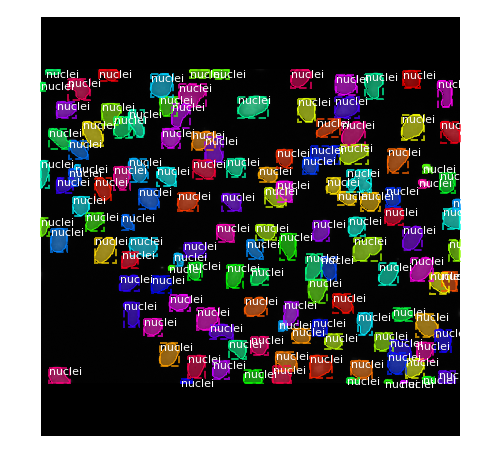

Processing 1 images
image                    shape: (512, 512, 3)         min:    0.00000  max:  255.00000
molded_images            shape: (1, 512, 512, 3)      min:    0.00000  max:  255.00000
image_metas              shape: (1, 10)               min:    0.00000  max:  512.00000


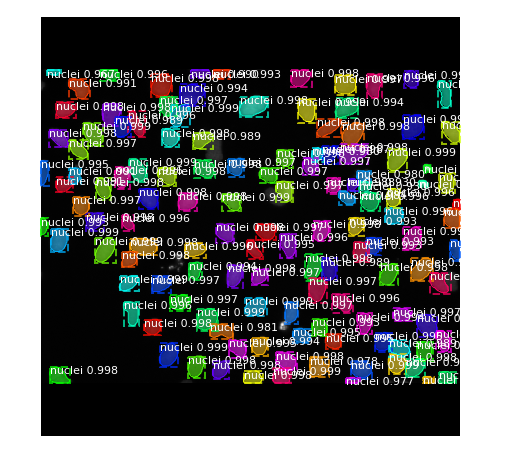

original_image           shape: (512, 512, 3)         min:    0.00000  max:  235.00000
image_meta               shape: (10,)                 min:    0.00000  max:  640.00000
gt_class_id              shape: (44,)                 min:    1.00000  max:    1.00000
gt_bbox                  shape: (44, 4)               min:    0.00000  max:  512.00000
gt_mask                  shape: (512, 512, 44)        min:    0.00000  max:    1.00000


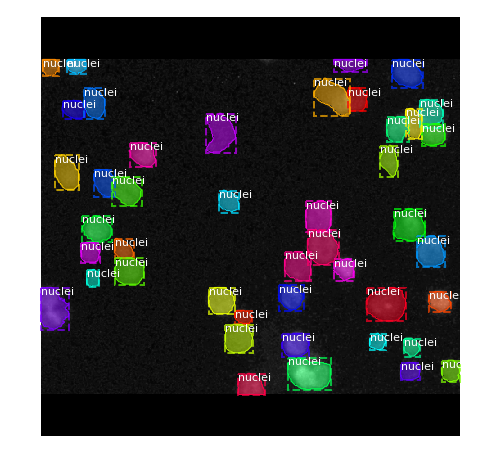

Processing 1 images
image                    shape: (512, 512, 3)         min:    0.00000  max:  235.00000
molded_images            shape: (1, 512, 512, 3)      min:    0.00000  max:  235.00000
image_metas              shape: (1, 10)               min:    0.00000  max:  512.00000


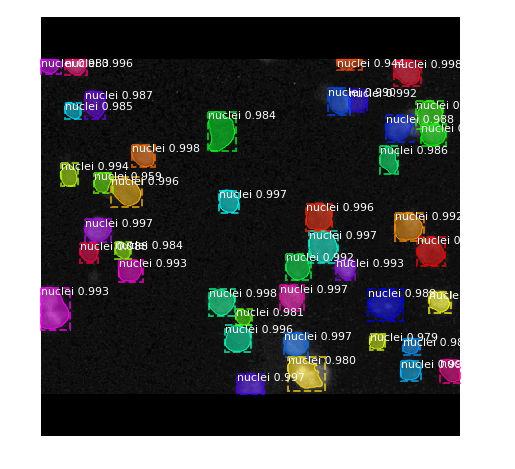

original_image           shape: (512, 512, 3)         min:    0.00000  max:  243.00000
image_meta               shape: (10,)                 min:    0.00000  max:  696.00000
gt_class_id              shape: (130,)                min:    1.00000  max:    1.00000
gt_bbox                  shape: (130, 4)              min:    0.00000  max:  512.00000
gt_mask                  shape: (512, 512, 130)       min:    0.00000  max:    1.00000


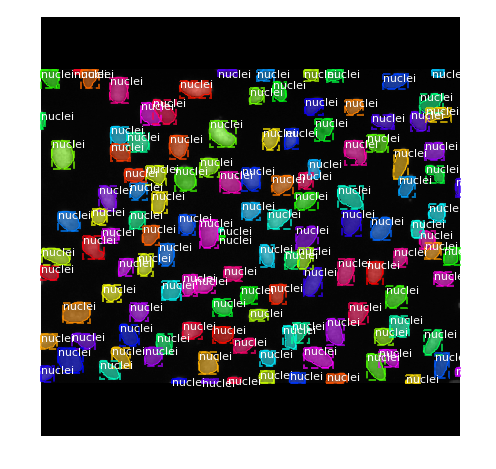

Processing 1 images
image                    shape: (512, 512, 3)         min:    0.00000  max:  243.00000
molded_images            shape: (1, 512, 512, 3)      min:    0.00000  max:  243.00000
image_metas              shape: (1, 10)               min:    0.00000  max:  512.00000


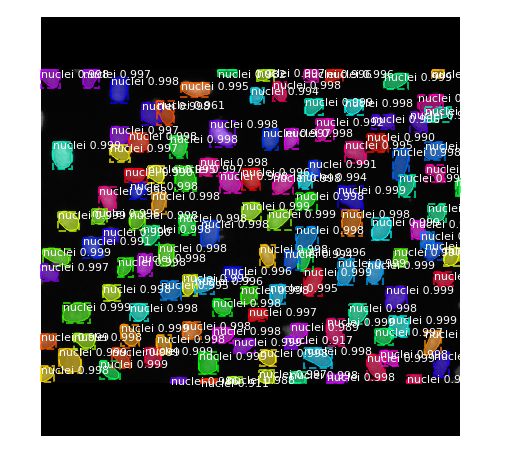

original_image           shape: (512, 512, 3)         min:    0.00000  max:  242.00000
image_meta               shape: (10,)                 min:    0.00000  max:  696.00000
gt_class_id              shape: (191,)                min:    1.00000  max:    1.00000
gt_bbox                  shape: (191, 4)              min:    0.00000  max:  512.00000
gt_mask                  shape: (512, 512, 191)       min:    0.00000  max:    1.00000


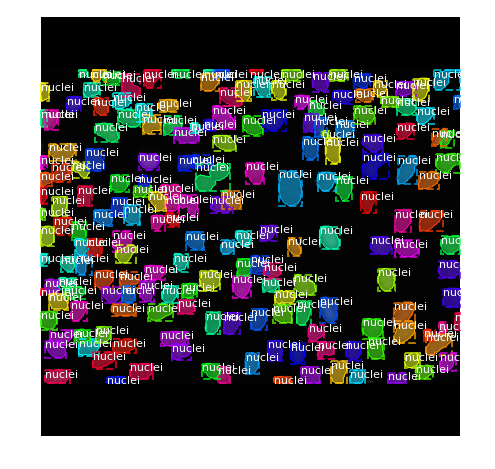

Processing 1 images
image                    shape: (512, 512, 3)         min:    0.00000  max:  242.00000
molded_images            shape: (1, 512, 512, 3)      min:    0.00000  max:  242.00000
image_metas              shape: (1, 10)               min:    0.00000  max:  512.00000


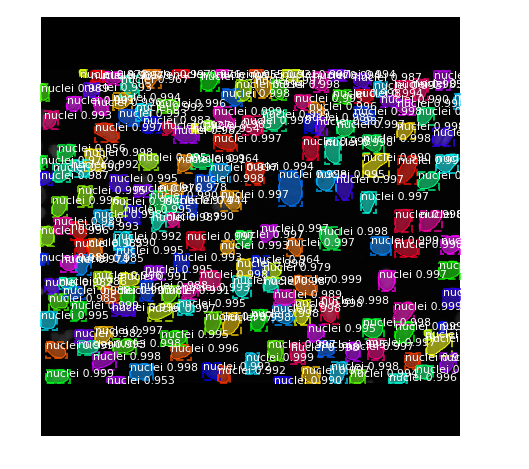

original_image           shape: (512, 512, 3)         min:    0.00000  max:  250.00000
image_meta               shape: (10,)                 min:    0.00000  max:  696.00000
gt_class_id              shape: (119,)                min:    1.00000  max:    1.00000
gt_bbox                  shape: (119, 4)              min:    0.00000  max:  512.00000
gt_mask                  shape: (512, 512, 119)       min:    0.00000  max:    1.00000


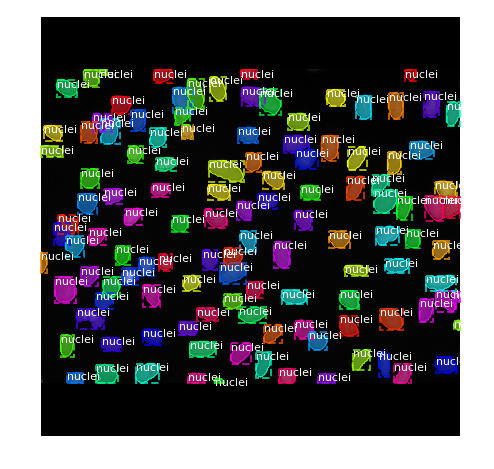

Processing 1 images
image                    shape: (512, 512, 3)         min:    0.00000  max:  250.00000
molded_images            shape: (1, 512, 512, 3)      min:    0.00000  max:  250.00000
image_metas              shape: (1, 10)               min:    0.00000  max:  512.00000


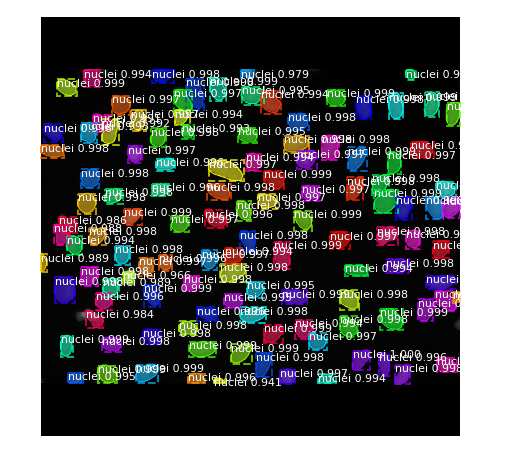

original_image           shape: (512, 512, 3)         min:    0.00000  max:  247.00000
image_meta               shape: (10,)                 min:    0.00000  max:  512.00000
gt_class_id              shape: (79,)                 min:    1.00000  max:    1.00000
gt_bbox                  shape: (79, 4)               min:    0.00000  max:  512.00000
gt_mask                  shape: (512, 512, 79)        min:    0.00000  max:    1.00000


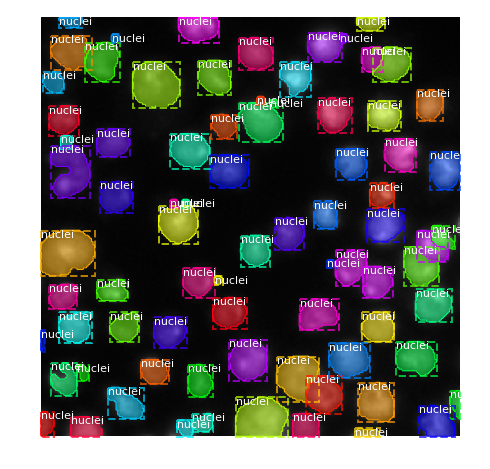

Processing 1 images
image                    shape: (512, 512, 3)         min:    0.00000  max:  247.00000
molded_images            shape: (1, 512, 512, 3)      min:    0.00000  max:  247.00000
image_metas              shape: (1, 10)               min:    0.00000  max:  512.00000


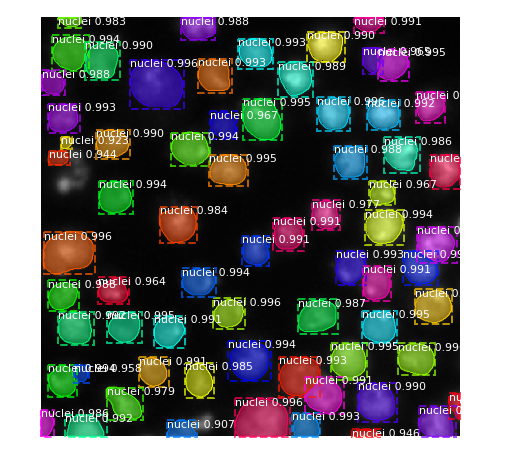

original_image           shape: (512, 512, 3)         min:    0.00000  max:  252.00000
image_meta               shape: (10,)                 min:    0.00000  max:  512.00000
gt_class_id              shape: (12,)                 min:    1.00000  max:    1.00000
gt_bbox                  shape: (12, 4)               min:   12.00000  max:  510.00000
gt_mask                  shape: (512, 512, 12)        min:    0.00000  max:    1.00000


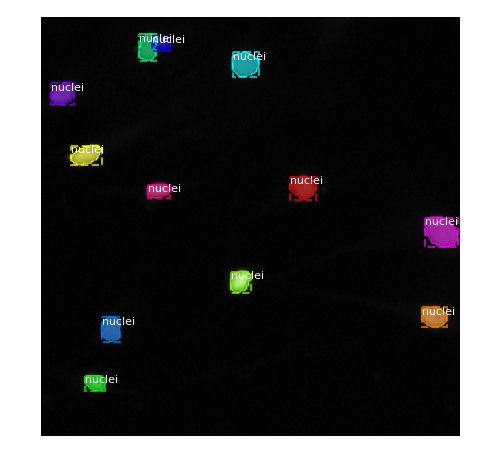

Processing 1 images
image                    shape: (512, 512, 3)         min:    0.00000  max:  252.00000
molded_images            shape: (1, 512, 512, 3)      min:    0.00000  max:  252.00000
image_metas              shape: (1, 10)               min:    0.00000  max:  512.00000


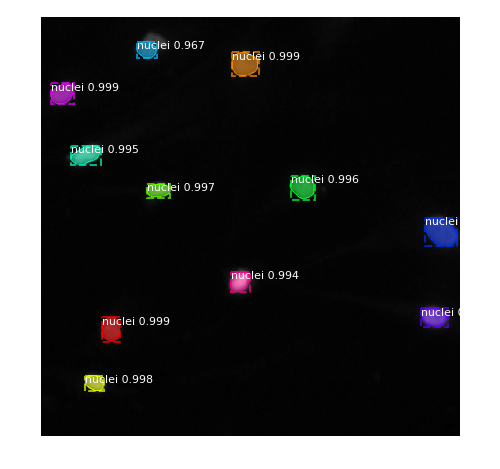

original_image           shape: (512, 512, 3)         min:    1.00000  max:  252.00000
image_meta               shape: (10,)                 min:    0.00000  max:  512.00000
gt_class_id              shape: (9,)                  min:    1.00000  max:    1.00000
gt_bbox                  shape: (9, 4)                min:   20.00000  max:  512.00000
gt_mask                  shape: (512, 512, 9)         min:    0.00000  max:    1.00000


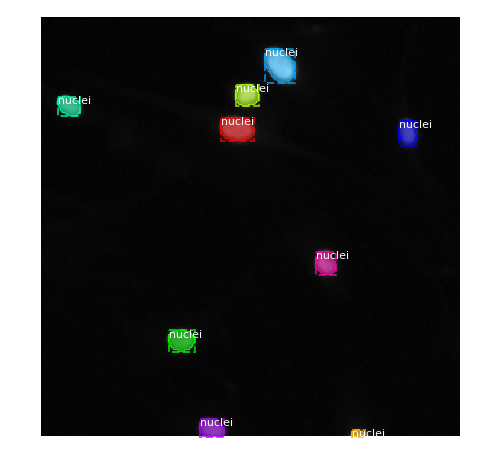

Processing 1 images
image                    shape: (512, 512, 3)         min:    1.00000  max:  252.00000
molded_images            shape: (1, 512, 512, 3)      min:    1.00000  max:  252.00000
image_metas              shape: (1, 10)               min:    0.00000  max:  512.00000


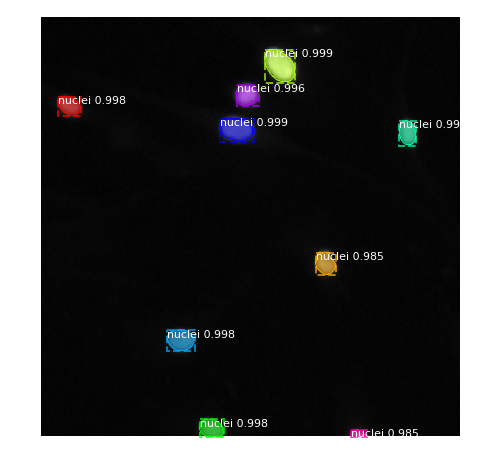

original_image           shape: (512, 512, 3)         min:    1.00000  max:  255.00000
image_meta               shape: (10,)                 min:    0.00000  max:  512.00000
gt_class_id              shape: (30,)                 min:    1.00000  max:    1.00000
gt_bbox                  shape: (30, 4)               min:    0.00000  max:  512.00000
gt_mask                  shape: (512, 512, 30)        min:    0.00000  max:    1.00000


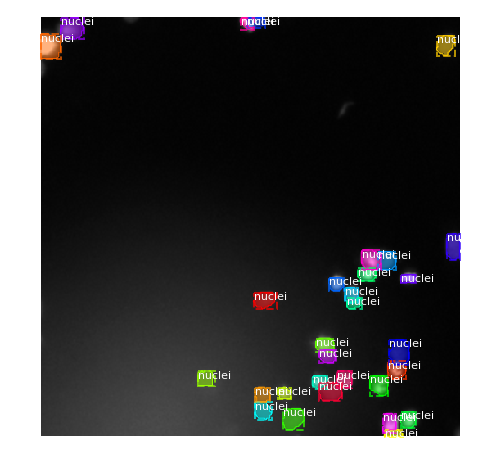

Processing 1 images
image                    shape: (512, 512, 3)         min:    1.00000  max:  255.00000
molded_images            shape: (1, 512, 512, 3)      min:    1.00000  max:  255.00000
image_metas              shape: (1, 10)               min:    0.00000  max:  512.00000


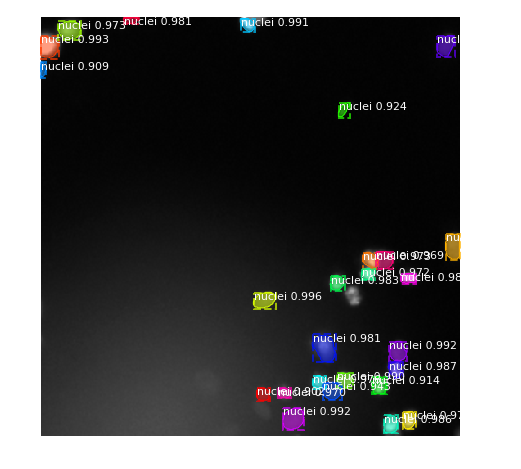

original_image           shape: (512, 512, 3)         min:    1.00000  max:  255.00000
image_meta               shape: (10,)                 min:    0.00000  max:  512.00000
gt_class_id              shape: (20,)                 min:    1.00000  max:    1.00000
gt_bbox                  shape: (20, 4)               min:    0.00000  max:  508.00000
gt_mask                  shape: (512, 512, 20)        min:    0.00000  max:    1.00000


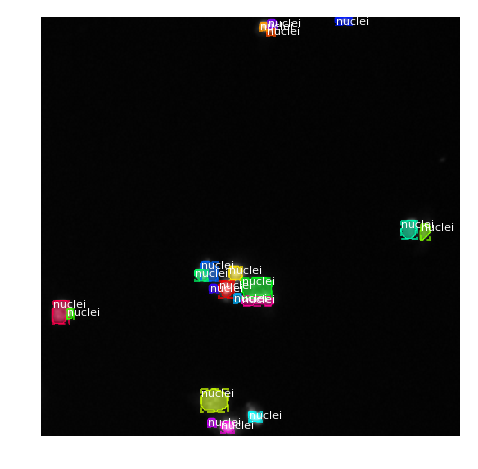

Processing 1 images
image                    shape: (512, 512, 3)         min:    1.00000  max:  255.00000
molded_images            shape: (1, 512, 512, 3)      min:    1.00000  max:  255.00000
image_metas              shape: (1, 10)               min:    0.00000  max:  512.00000


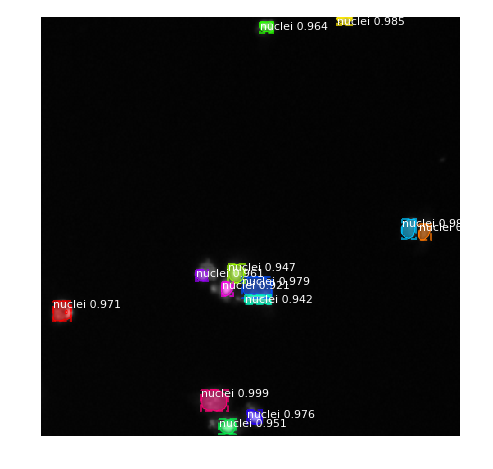

original_image           shape: (512, 512, 3)         min:    1.00000  max:  251.00000
image_meta               shape: (10,)                 min:    0.00000  max:  512.00000
gt_class_id              shape: (31,)                 min:    1.00000  max:    1.00000
gt_bbox                  shape: (31, 4)               min:    0.00000  max:  512.00000
gt_mask                  shape: (512, 512, 31)        min:    0.00000  max:    1.00000


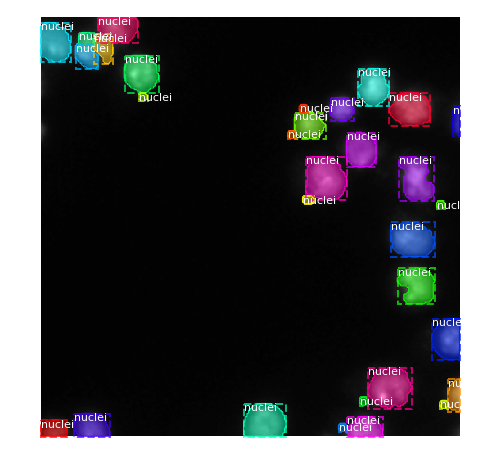

Processing 1 images
image                    shape: (512, 512, 3)         min:    1.00000  max:  251.00000
molded_images            shape: (1, 512, 512, 3)      min:    1.00000  max:  251.00000
image_metas              shape: (1, 10)               min:    0.00000  max:  512.00000


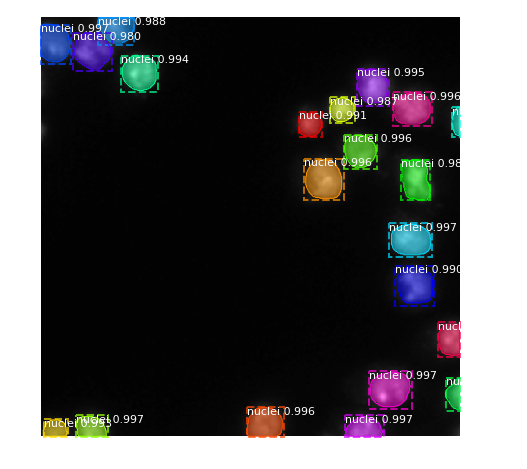

original_image           shape: (512, 512, 3)         min:    1.00000  max:  255.00000
image_meta               shape: (10,)                 min:    0.00000  max:  512.00000
gt_class_id              shape: (15,)                 min:    1.00000  max:    1.00000
gt_bbox                  shape: (15, 4)               min:    0.00000  max:  438.00000
gt_mask                  shape: (512, 512, 15)        min:    0.00000  max:    1.00000


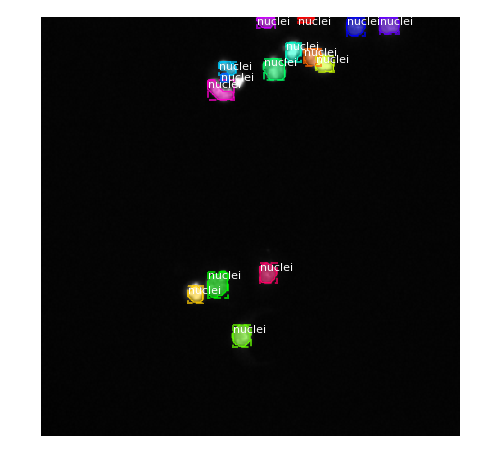

Processing 1 images
image                    shape: (512, 512, 3)         min:    1.00000  max:  255.00000
molded_images            shape: (1, 512, 512, 3)      min:    1.00000  max:  255.00000
image_metas              shape: (1, 10)               min:    0.00000  max:  512.00000


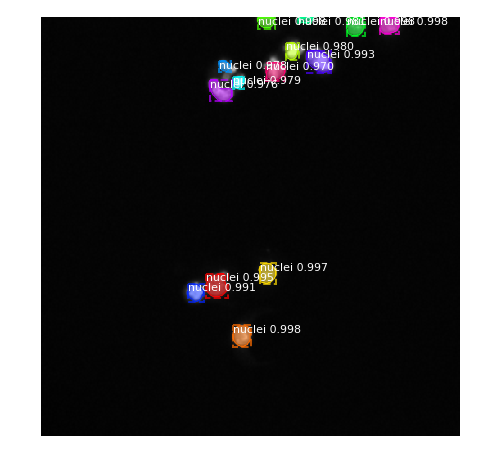

original_image           shape: (512, 512, 3)         min:    1.00000  max:  255.00000
image_meta               shape: (10,)                 min:    0.00000  max:  512.00000
gt_class_id              shape: (7,)                  min:    1.00000  max:    1.00000
gt_bbox                  shape: (7, 4)                min:   84.00000  max:  490.00000
gt_mask                  shape: (512, 512, 7)         min:    0.00000  max:    1.00000


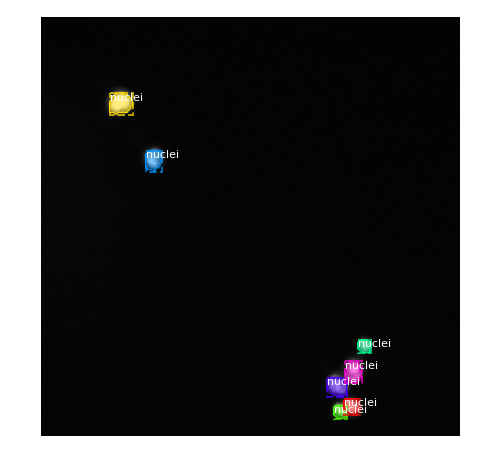

Processing 1 images
image                    shape: (512, 512, 3)         min:    1.00000  max:  255.00000
molded_images            shape: (1, 512, 512, 3)      min:    1.00000  max:  255.00000
image_metas              shape: (1, 10)               min:    0.00000  max:  512.00000


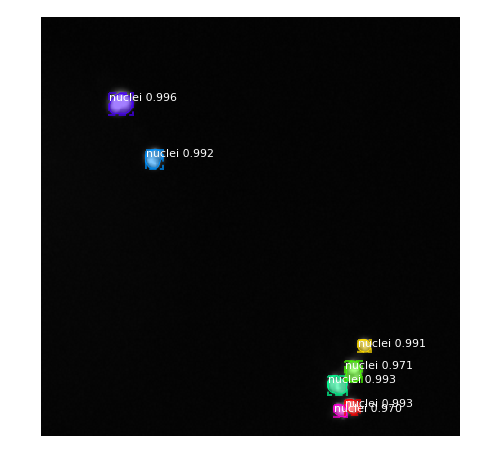

original_image           shape: (512, 512, 3)         min:    1.00000  max:  249.00000
image_meta               shape: (10,)                 min:    0.00000  max:  512.00000
gt_class_id              shape: (9,)                  min:    1.00000  max:    1.00000
gt_bbox                  shape: (9, 4)                min:    8.00000  max:  474.00000
gt_mask                  shape: (512, 512, 9)         min:    0.00000  max:    1.00000


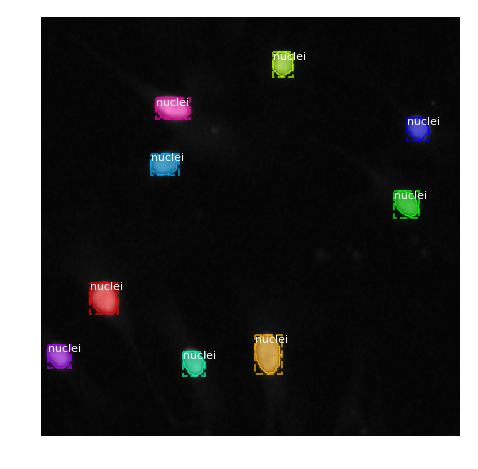

Processing 1 images
image                    shape: (512, 512, 3)         min:    1.00000  max:  249.00000
molded_images            shape: (1, 512, 512, 3)      min:    1.00000  max:  249.00000
image_metas              shape: (1, 10)               min:    0.00000  max:  512.00000


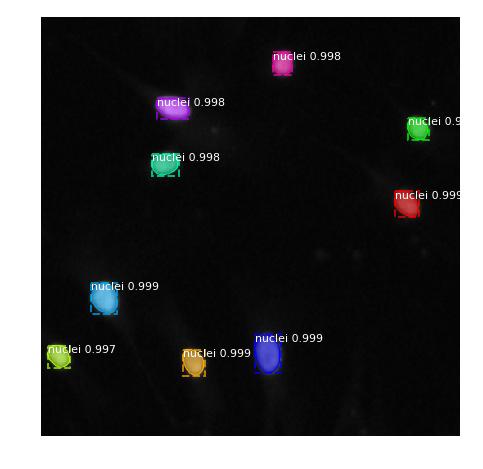

original_image           shape: (512, 512, 3)         min:    0.00000  max:  249.00000
image_meta               shape: (10,)                 min:    0.00000  max:  512.00000
gt_class_id              shape: (12,)                 min:    1.00000  max:    1.00000
gt_bbox                  shape: (12, 4)               min:   18.00000  max:  474.00000
gt_mask                  shape: (512, 512, 12)        min:    0.00000  max:    1.00000


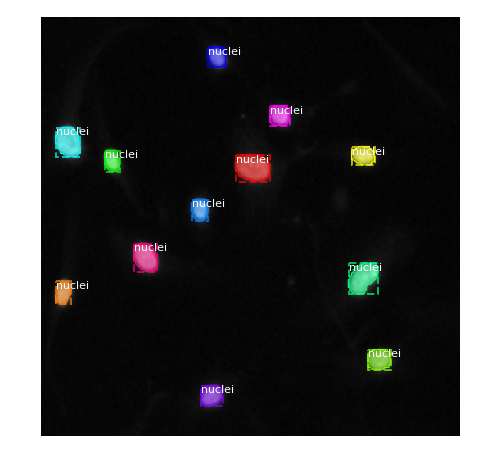

Processing 1 images
image                    shape: (512, 512, 3)         min:    0.00000  max:  249.00000
molded_images            shape: (1, 512, 512, 3)      min:    0.00000  max:  249.00000
image_metas              shape: (1, 10)               min:    0.00000  max:  512.00000


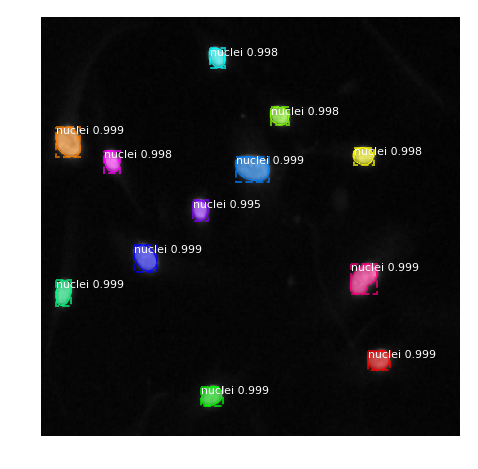

original_image           shape: (512, 512, 3)         min:    0.00000  max:  254.00000
image_meta               shape: (10,)                 min:    0.00000  max:  512.00000
gt_class_id              shape: (15,)                 min:    1.00000  max:    1.00000
gt_bbox                  shape: (15, 4)               min:    0.00000  max:  512.00000
gt_mask                  shape: (512, 512, 15)        min:    0.00000  max:    1.00000


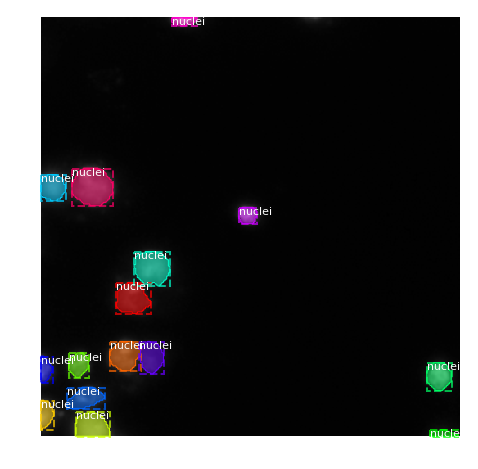

Processing 1 images
image                    shape: (512, 512, 3)         min:    0.00000  max:  254.00000
molded_images            shape: (1, 512, 512, 3)      min:    0.00000  max:  254.00000
image_metas              shape: (1, 10)               min:    0.00000  max:  512.00000


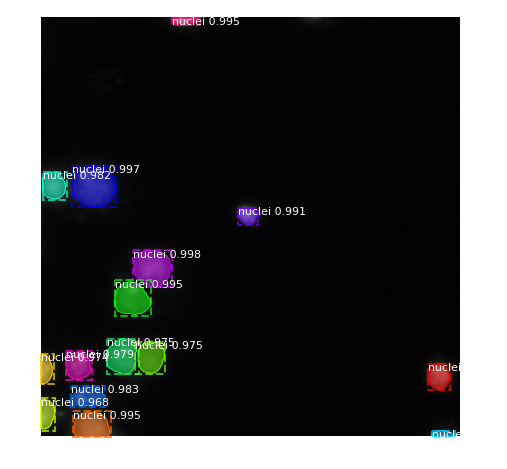

original_image           shape: (512, 512, 3)         min:    2.00000  max:  249.00000
image_meta               shape: (10,)                 min:    0.00000  max:  512.00000
gt_class_id              shape: (11,)                 min:    1.00000  max:    1.00000
gt_bbox                  shape: (11, 4)               min:    0.00000  max:  512.00000
gt_mask                  shape: (512, 512, 11)        min:    0.00000  max:    1.00000


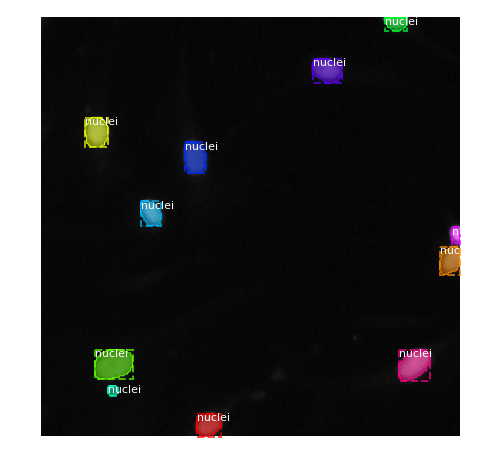

Processing 1 images
image                    shape: (512, 512, 3)         min:    2.00000  max:  249.00000
molded_images            shape: (1, 512, 512, 3)      min:    2.00000  max:  249.00000
image_metas              shape: (1, 10)               min:    0.00000  max:  512.00000


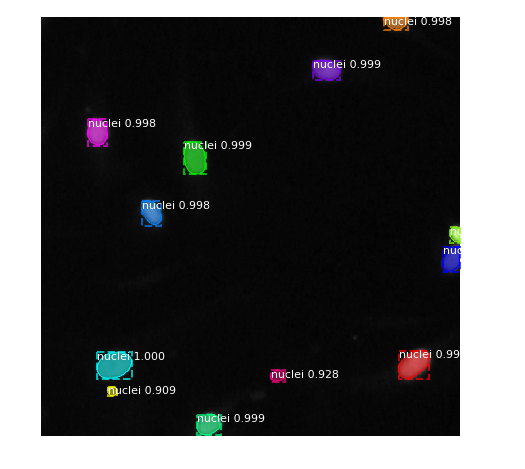

original_image           shape: (512, 512, 3)         min:    2.00000  max:  252.00000
image_meta               shape: (10,)                 min:    0.00000  max:  512.00000
gt_class_id              shape: (13,)                 min:    1.00000  max:    1.00000
gt_bbox                  shape: (13, 4)               min:    0.00000  max:  512.00000
gt_mask                  shape: (512, 512, 13)        min:    0.00000  max:    1.00000


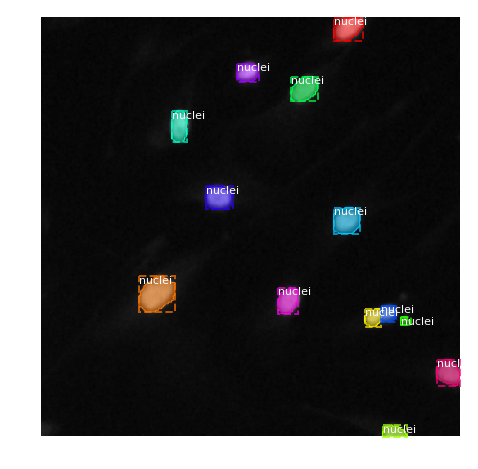

Processing 1 images
image                    shape: (512, 512, 3)         min:    2.00000  max:  252.00000
molded_images            shape: (1, 512, 512, 3)      min:    2.00000  max:  252.00000
image_metas              shape: (1, 10)               min:    0.00000  max:  512.00000


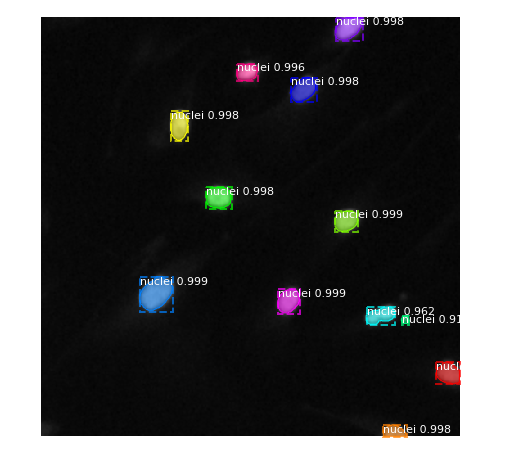

original_image           shape: (512, 512, 3)         min:    0.00000  max:  252.00000
image_meta               shape: (10,)                 min:    0.00000  max:  512.00000
gt_class_id              shape: (36,)                 min:    1.00000  max:    1.00000
gt_bbox                  shape: (36, 4)               min:    0.00000  max:  502.00000
gt_mask                  shape: (512, 512, 36)        min:    0.00000  max:    1.00000


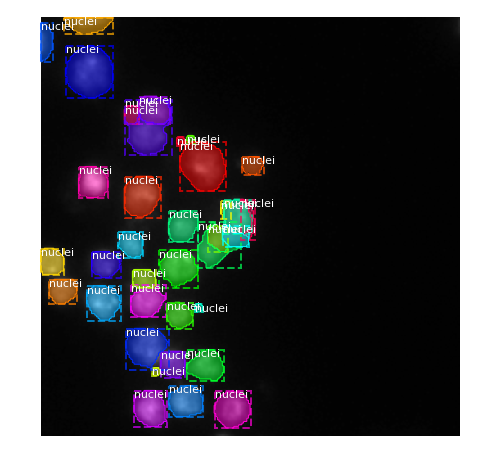

Processing 1 images
image                    shape: (512, 512, 3)         min:    0.00000  max:  252.00000
molded_images            shape: (1, 512, 512, 3)      min:    0.00000  max:  252.00000
image_metas              shape: (1, 10)               min:    0.00000  max:  512.00000


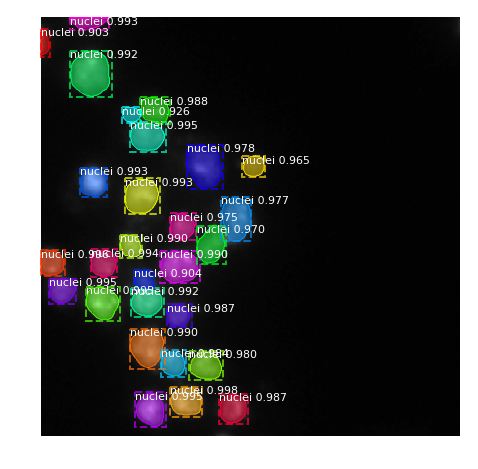

original_image           shape: (512, 512, 3)         min:    2.00000  max:  252.00000
image_meta               shape: (10,)                 min:    0.00000  max:  512.00000
gt_class_id              shape: (8,)                  min:    1.00000  max:    1.00000
gt_bbox                  shape: (8, 4)                min:   36.00000  max:  512.00000
gt_mask                  shape: (512, 512, 8)         min:    0.00000  max:    1.00000


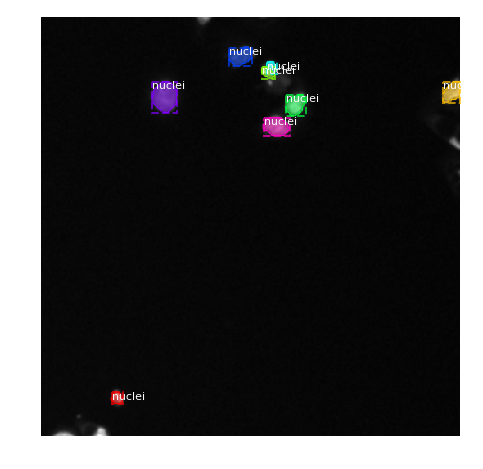

Processing 1 images
image                    shape: (512, 512, 3)         min:    2.00000  max:  252.00000
molded_images            shape: (1, 512, 512, 3)      min:    2.00000  max:  252.00000
image_metas              shape: (1, 10)               min:    0.00000  max:  512.00000


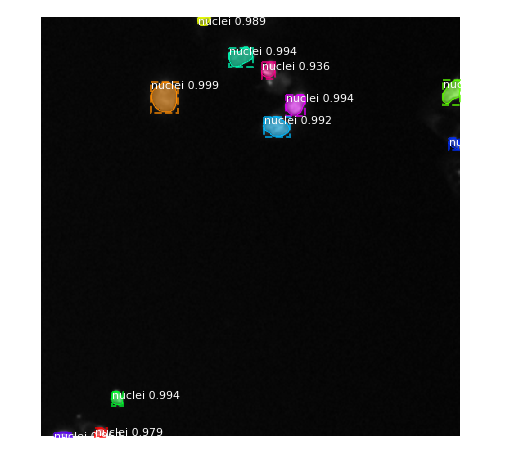

original_image           shape: (512, 512, 3)         min:    1.00000  max:  251.00000
image_meta               shape: (10,)                 min:    0.00000  max:  512.00000
gt_class_id              shape: (11,)                 min:    1.00000  max:    1.00000
gt_bbox                  shape: (11, 4)               min:    0.00000  max:  512.00000
gt_mask                  shape: (512, 512, 11)        min:    0.00000  max:    1.00000


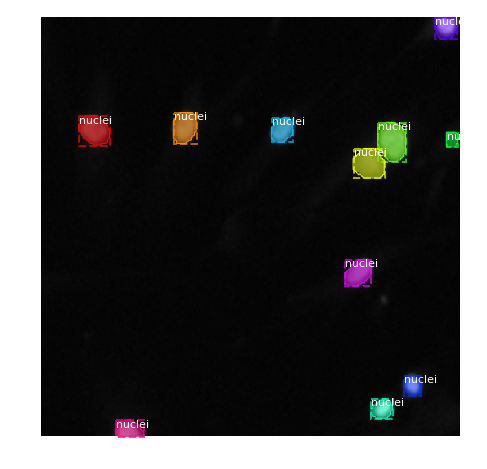

Processing 1 images
image                    shape: (512, 512, 3)         min:    1.00000  max:  251.00000
molded_images            shape: (1, 512, 512, 3)      min:    1.00000  max:  251.00000
image_metas              shape: (1, 10)               min:    0.00000  max:  512.00000


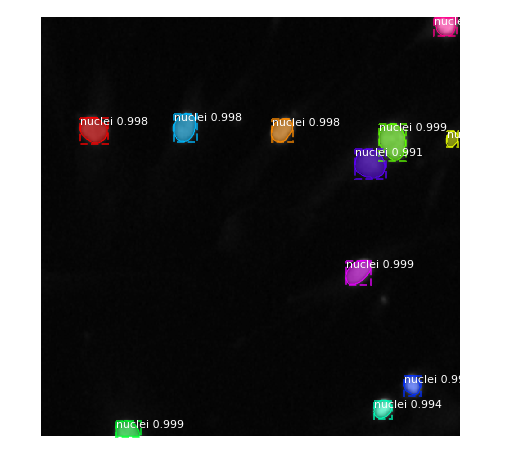

original_image           shape: (512, 512, 3)         min:    1.00000  max:  255.00000
image_meta               shape: (10,)                 min:    0.00000  max:  512.00000
gt_class_id              shape: (15,)                 min:    1.00000  max:    1.00000
gt_bbox                  shape: (15, 4)               min:    0.00000  max:  512.00000
gt_mask                  shape: (512, 512, 15)        min:    0.00000  max:    1.00000


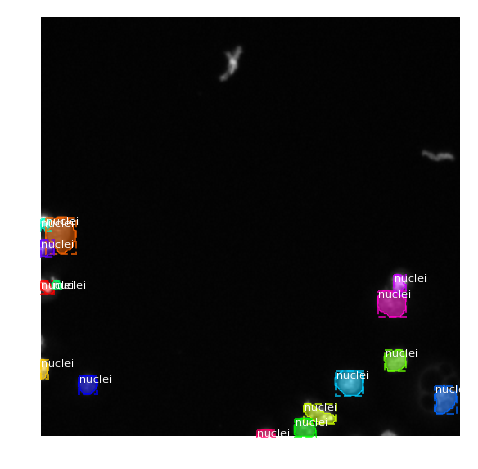

Processing 1 images
image                    shape: (512, 512, 3)         min:    1.00000  max:  255.00000
molded_images            shape: (1, 512, 512, 3)      min:    1.00000  max:  255.00000
image_metas              shape: (1, 10)               min:    0.00000  max:  512.00000


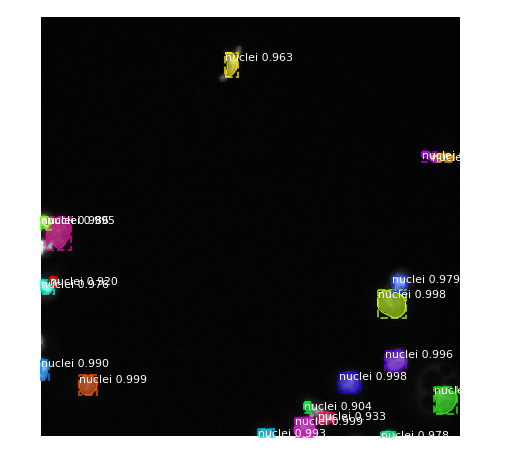

original_image           shape: (512, 512, 3)         min:    1.00000  max:  252.00000
image_meta               shape: (10,)                 min:    0.00000  max:  512.00000
gt_class_id              shape: (8,)                  min:    1.00000  max:    1.00000
gt_bbox                  shape: (8, 4)                min:    0.00000  max:  494.00000
gt_mask                  shape: (512, 512, 8)         min:    0.00000  max:    1.00000


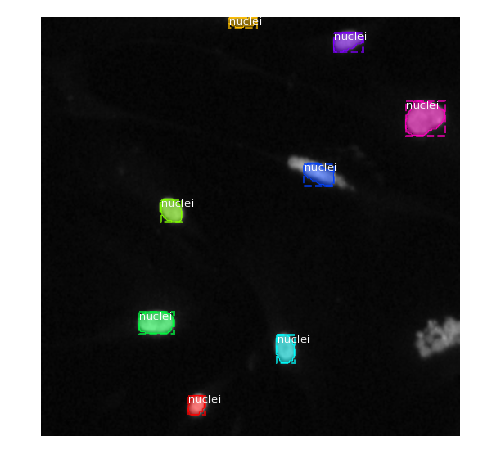

Processing 1 images
image                    shape: (512, 512, 3)         min:    1.00000  max:  252.00000
molded_images            shape: (1, 512, 512, 3)      min:    1.00000  max:  252.00000
image_metas              shape: (1, 10)               min:    0.00000  max:  512.00000


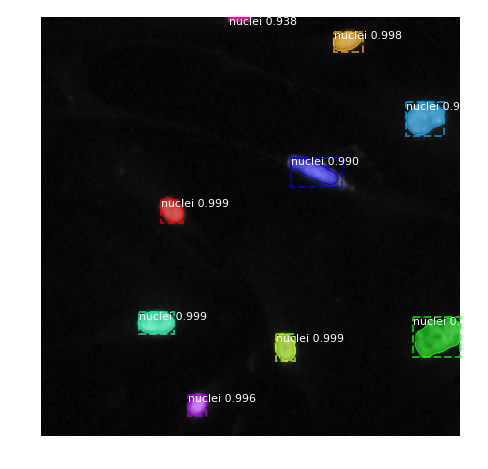

original_image           shape: (512, 512, 3)         min:    1.00000  max:  252.00000
image_meta               shape: (10,)                 min:    0.00000  max:  512.00000
gt_class_id              shape: (8,)                  min:    1.00000  max:    1.00000
gt_bbox                  shape: (8, 4)                min:    0.00000  max:  512.00000
gt_mask                  shape: (512, 512, 8)         min:    0.00000  max:    1.00000


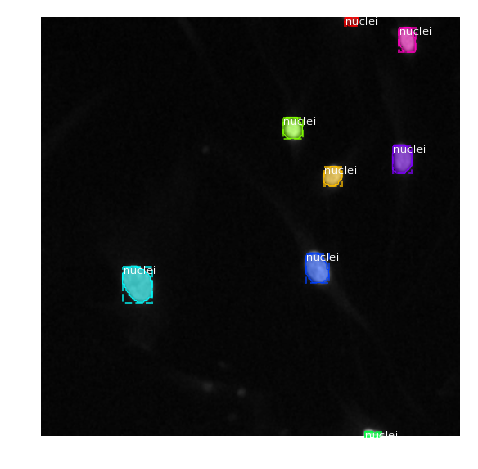

Processing 1 images
image                    shape: (512, 512, 3)         min:    1.00000  max:  252.00000
molded_images            shape: (1, 512, 512, 3)      min:    1.00000  max:  252.00000
image_metas              shape: (1, 10)               min:    0.00000  max:  512.00000


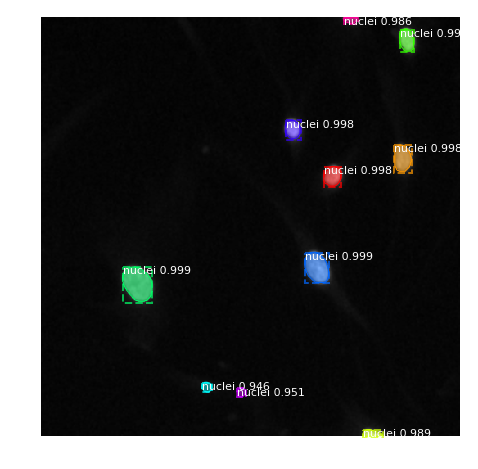

original_image           shape: (512, 512, 3)         min:    1.00000  max:  248.00000
image_meta               shape: (10,)                 min:    0.00000  max:  512.00000
gt_class_id              shape: (9,)                  min:    1.00000  max:    1.00000
gt_bbox                  shape: (9, 4)                min:    0.00000  max:  482.00000
gt_mask                  shape: (512, 512, 9)         min:    0.00000  max:    1.00000


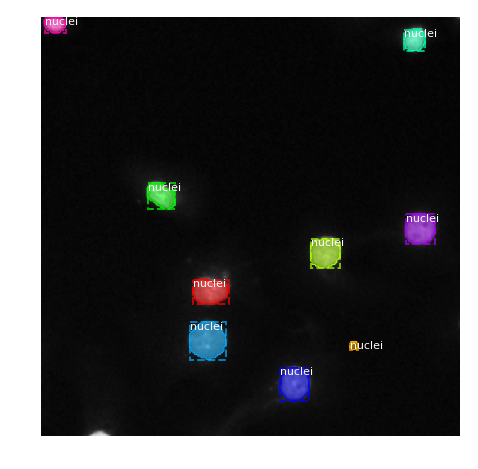

Processing 1 images
image                    shape: (512, 512, 3)         min:    1.00000  max:  248.00000
molded_images            shape: (1, 512, 512, 3)      min:    1.00000  max:  248.00000
image_metas              shape: (1, 10)               min:    0.00000  max:  512.00000


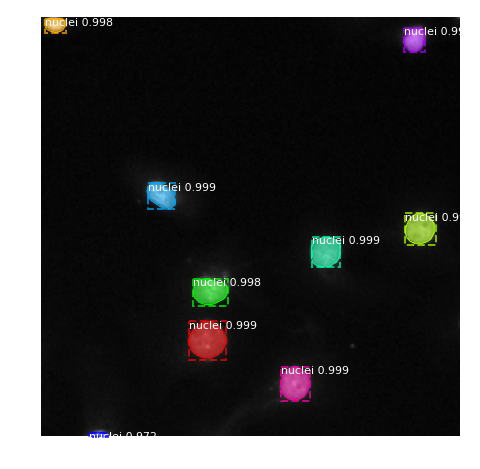

original_image           shape: (512, 512, 3)         min:    0.00000  max:  247.00000
image_meta               shape: (10,)                 min:    0.00000  max:  512.00000
gt_class_id              shape: (7,)                  min:    1.00000  max:    1.00000
gt_bbox                  shape: (7, 4)                min:    0.00000  max:  512.00000
gt_mask                  shape: (512, 512, 7)         min:    0.00000  max:    1.00000


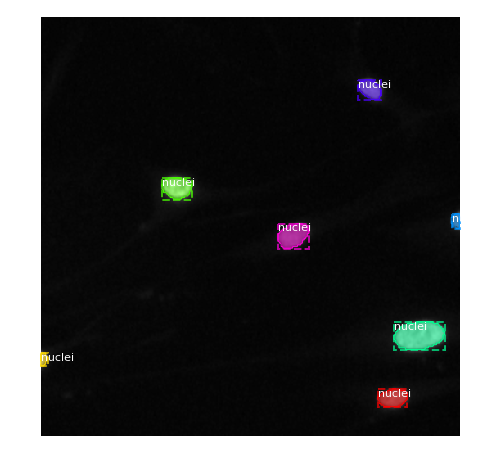

Processing 1 images
image                    shape: (512, 512, 3)         min:    0.00000  max:  247.00000
molded_images            shape: (1, 512, 512, 3)      min:    0.00000  max:  247.00000
image_metas              shape: (1, 10)               min:    0.00000  max:  512.00000


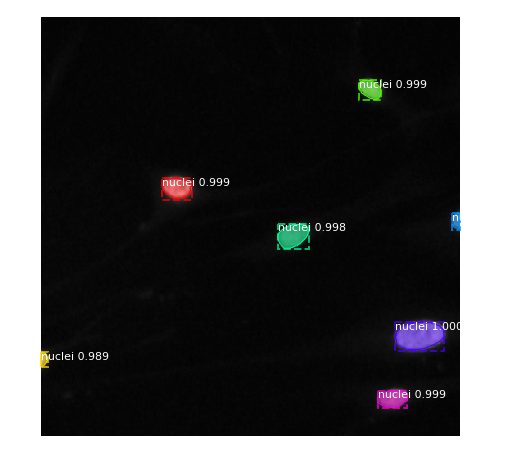

original_image           shape: (512, 512, 3)         min:    0.00000  max:  255.00000
image_meta               shape: (10,)                 min:    0.00000  max:  512.00000
gt_class_id              shape: (2,)                  min:    1.00000  max:    1.00000
gt_bbox                  shape: (2, 4)                min:  102.00000  max:  416.00000
gt_mask                  shape: (512, 512, 2)         min:    0.00000  max:    1.00000


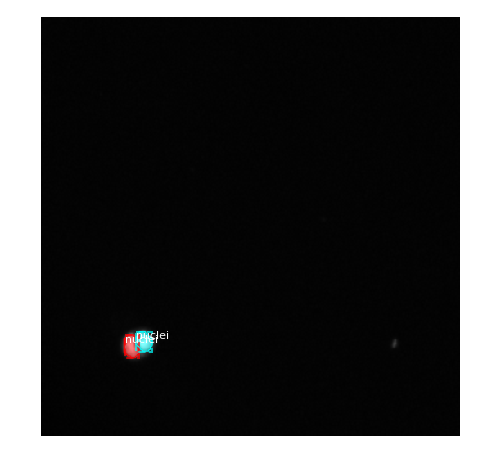

Processing 1 images
image                    shape: (512, 512, 3)         min:    0.00000  max:  255.00000
molded_images            shape: (1, 512, 512, 3)      min:    0.00000  max:  255.00000
image_metas              shape: (1, 10)               min:    0.00000  max:  512.00000


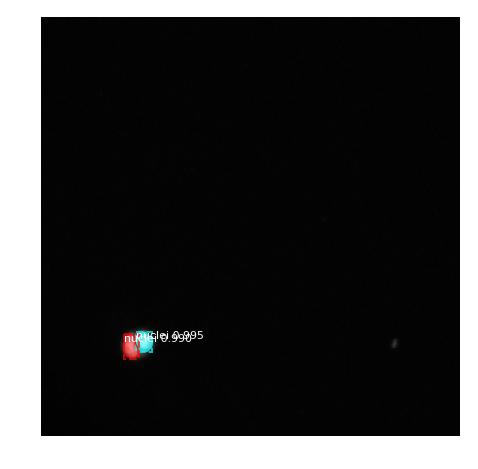

original_image           shape: (512, 512, 3)         min:    1.00000  max:  254.00000
image_meta               shape: (10,)                 min:    0.00000  max:  512.00000
gt_class_id              shape: (7,)                  min:    1.00000  max:    1.00000
gt_bbox                  shape: (7, 4)                min:    0.00000  max:  484.00000
gt_mask                  shape: (512, 512, 7)         min:    0.00000  max:    1.00000


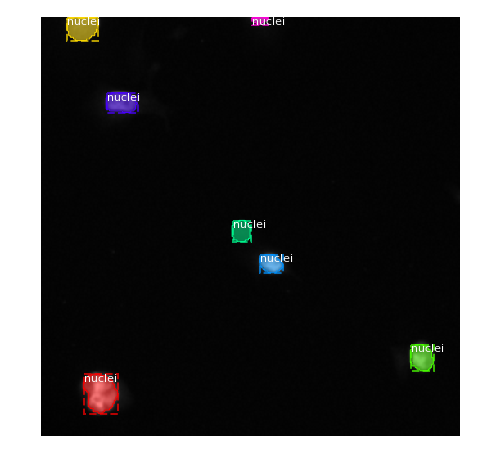

Processing 1 images
image                    shape: (512, 512, 3)         min:    1.00000  max:  254.00000
molded_images            shape: (1, 512, 512, 3)      min:    1.00000  max:  254.00000
image_metas              shape: (1, 10)               min:    0.00000  max:  512.00000


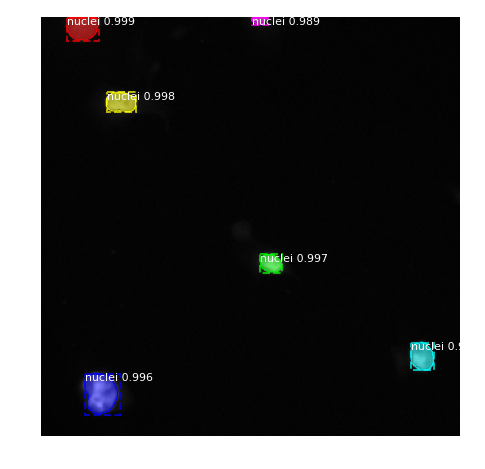

original_image           shape: (512, 512, 3)         min:    1.00000  max:  250.00000
image_meta               shape: (10,)                 min:    0.00000  max:  512.00000
gt_class_id              shape: (6,)                  min:    1.00000  max:    1.00000
gt_bbox                  shape: (6, 4)                min:   48.00000  max:  512.00000
gt_mask                  shape: (512, 512, 6)         min:    0.00000  max:    1.00000


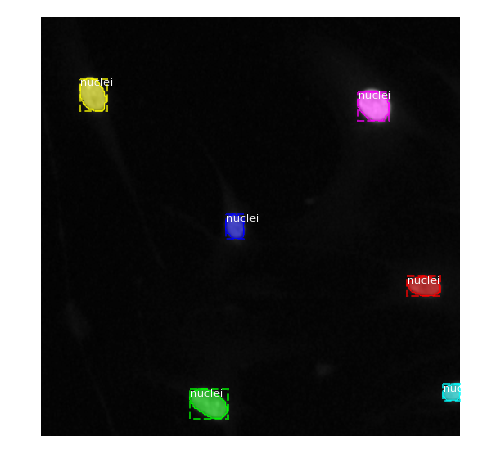

Processing 1 images
image                    shape: (512, 512, 3)         min:    1.00000  max:  250.00000
molded_images            shape: (1, 512, 512, 3)      min:    1.00000  max:  250.00000
image_metas              shape: (1, 10)               min:    0.00000  max:  512.00000


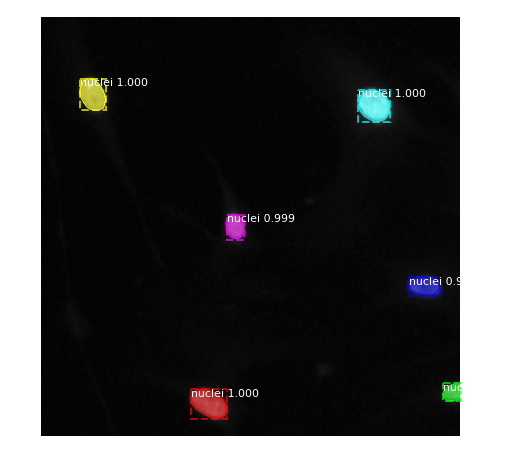

original_image           shape: (512, 512, 3)         min:    0.00000  max:  252.00000
image_meta               shape: (10,)                 min:    0.00000  max:  512.00000
gt_class_id              shape: (6,)                  min:    1.00000  max:    1.00000
gt_bbox                  shape: (6, 4)                min:   16.00000  max:  424.00000
gt_mask                  shape: (512, 512, 6)         min:    0.00000  max:    1.00000


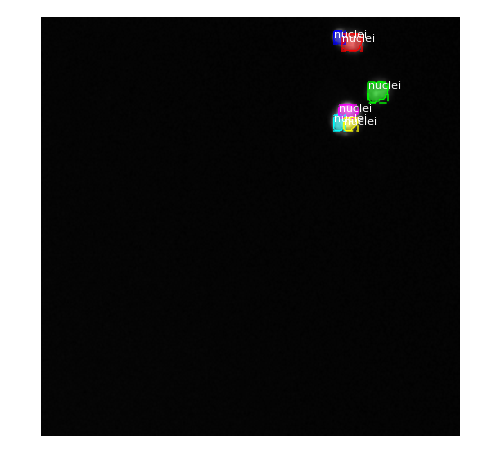

Processing 1 images
image                    shape: (512, 512, 3)         min:    0.00000  max:  252.00000
molded_images            shape: (1, 512, 512, 3)      min:    0.00000  max:  252.00000
image_metas              shape: (1, 10)               min:    0.00000  max:  512.00000


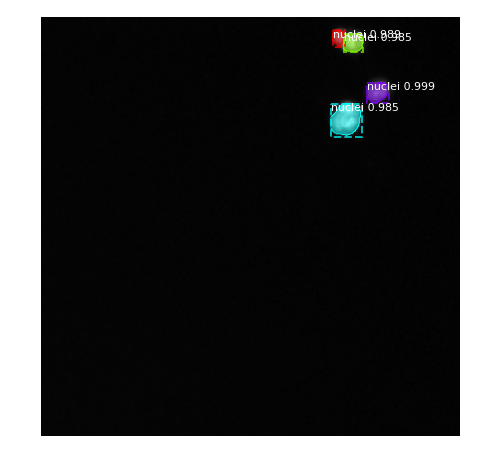

original_image           shape: (512, 512, 3)         min:    1.00000  max:  252.00000
image_meta               shape: (10,)                 min:    0.00000  max:  512.00000
gt_class_id              shape: (14,)                 min:    1.00000  max:    1.00000
gt_bbox                  shape: (14, 4)               min:    0.00000  max:  512.00000
gt_mask                  shape: (512, 512, 14)        min:    0.00000  max:    1.00000


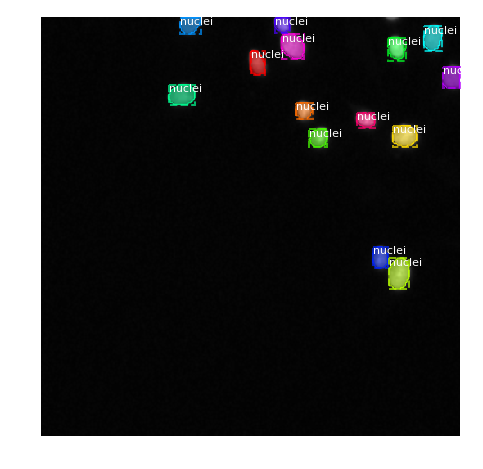

Processing 1 images
image                    shape: (512, 512, 3)         min:    1.00000  max:  252.00000
molded_images            shape: (1, 512, 512, 3)      min:    1.00000  max:  252.00000
image_metas              shape: (1, 10)               min:    0.00000  max:  512.00000


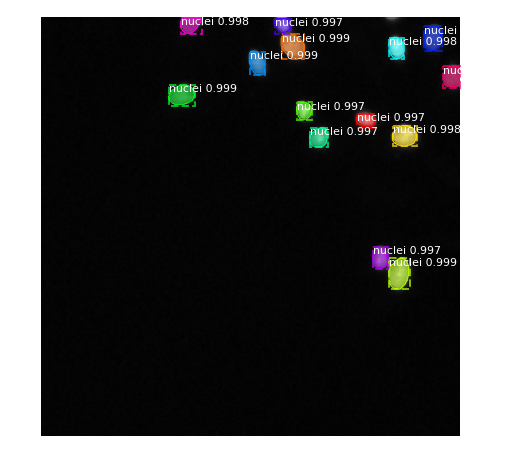

original_image           shape: (512, 512, 3)         min:    2.00000  max:  249.00000
image_meta               shape: (10,)                 min:    0.00000  max:  512.00000
gt_class_id              shape: (39,)                 min:    1.00000  max:    1.00000
gt_bbox                  shape: (39, 4)               min:    0.00000  max:  512.00000
gt_mask                  shape: (512, 512, 39)        min:    0.00000  max:    1.00000


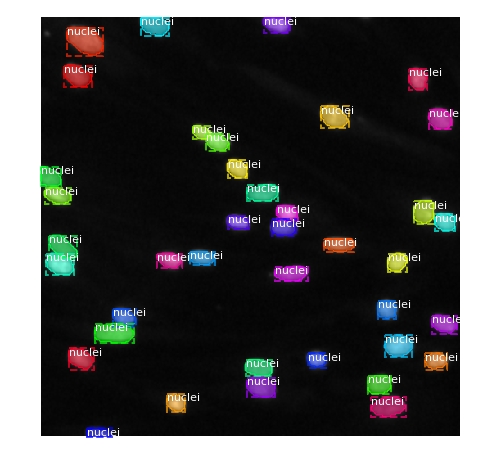

Processing 1 images
image                    shape: (512, 512, 3)         min:    2.00000  max:  249.00000
molded_images            shape: (1, 512, 512, 3)      min:    2.00000  max:  249.00000
image_metas              shape: (1, 10)               min:    0.00000  max:  512.00000


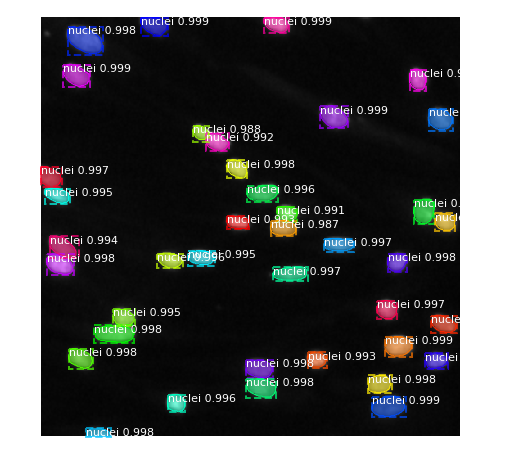

original_image           shape: (512, 512, 3)         min:    1.00000  max:  253.00000
image_meta               shape: (10,)                 min:    0.00000  max:  512.00000
gt_class_id              shape: (38,)                 min:    1.00000  max:    1.00000
gt_bbox                  shape: (38, 4)               min:    0.00000  max:  512.00000
gt_mask                  shape: (512, 512, 38)        min:    0.00000  max:    1.00000


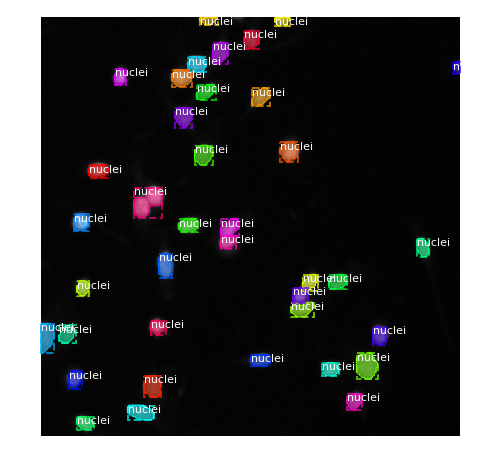

Processing 1 images
image                    shape: (512, 512, 3)         min:    1.00000  max:  253.00000
molded_images            shape: (1, 512, 512, 3)      min:    1.00000  max:  253.00000
image_metas              shape: (1, 10)               min:    0.00000  max:  512.00000


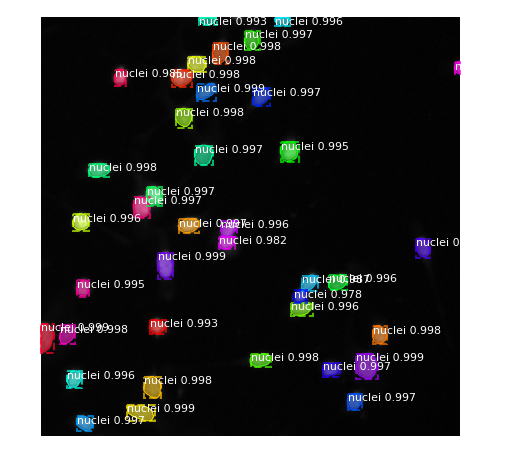

original_image           shape: (512, 512, 3)         min:    1.00000  max:  255.00000
image_meta               shape: (10,)                 min:    0.00000  max:  512.00000
gt_class_id              shape: (32,)                 min:    1.00000  max:    1.00000
gt_bbox                  shape: (32, 4)               min:    0.00000  max:  512.00000
gt_mask                  shape: (512, 512, 32)        min:    0.00000  max:    1.00000


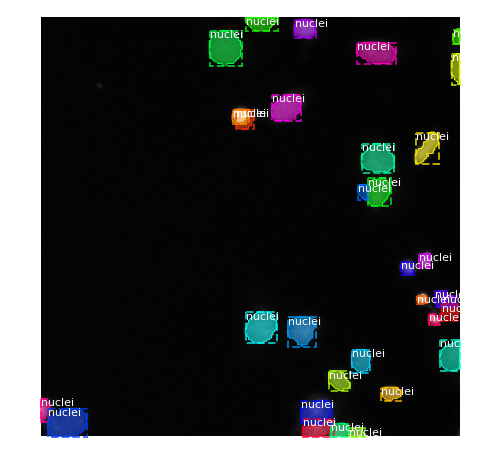

Processing 1 images
image                    shape: (512, 512, 3)         min:    1.00000  max:  255.00000
molded_images            shape: (1, 512, 512, 3)      min:    1.00000  max:  255.00000
image_metas              shape: (1, 10)               min:    0.00000  max:  512.00000


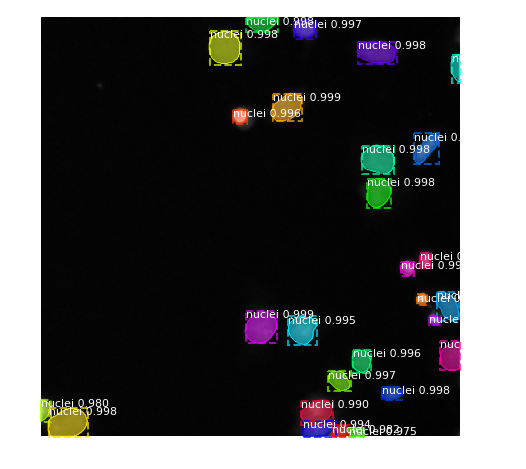

original_image           shape: (512, 512, 3)         min:    2.00000  max:  244.00000
image_meta               shape: (10,)                 min:    0.00000  max:  512.00000
gt_class_id              shape: (35,)                 min:    1.00000  max:    1.00000
gt_bbox                  shape: (35, 4)               min:    0.00000  max:  512.00000
gt_mask                  shape: (512, 512, 35)        min:    0.00000  max:    1.00000


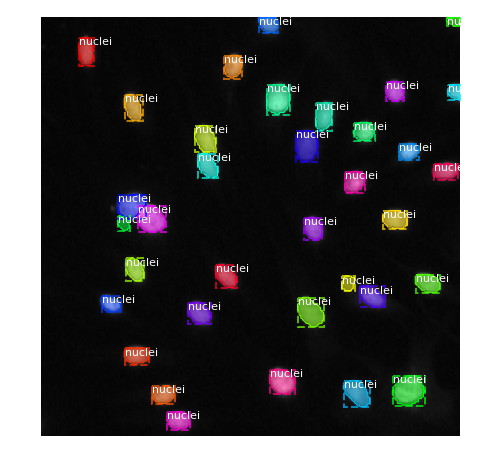

Processing 1 images
image                    shape: (512, 512, 3)         min:    2.00000  max:  244.00000
molded_images            shape: (1, 512, 512, 3)      min:    2.00000  max:  244.00000
image_metas              shape: (1, 10)               min:    0.00000  max:  512.00000


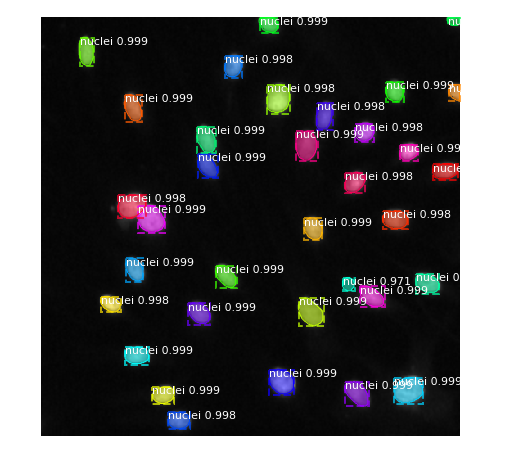

original_image           shape: (512, 512, 3)         min:    0.00000  max:  253.00000
image_meta               shape: (10,)                 min:    0.00000  max:  696.00000
gt_class_id              shape: (49,)                 min:    1.00000  max:    1.00000
gt_bbox                  shape: (49, 4)               min:    0.00000  max:  512.00000
gt_mask                  shape: (512, 512, 49)        min:    0.00000  max:    1.00000


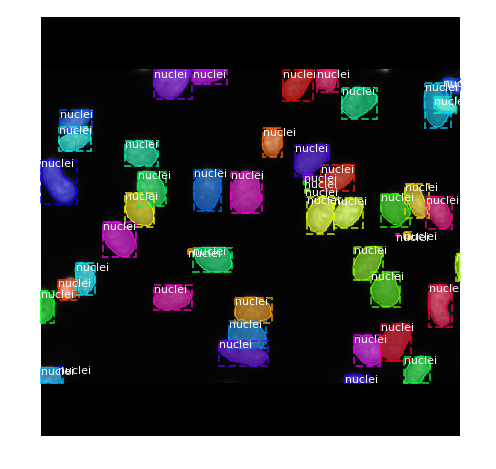

Processing 1 images
image                    shape: (512, 512, 3)         min:    0.00000  max:  253.00000
molded_images            shape: (1, 512, 512, 3)      min:    0.00000  max:  253.00000
image_metas              shape: (1, 10)               min:    0.00000  max:  512.00000


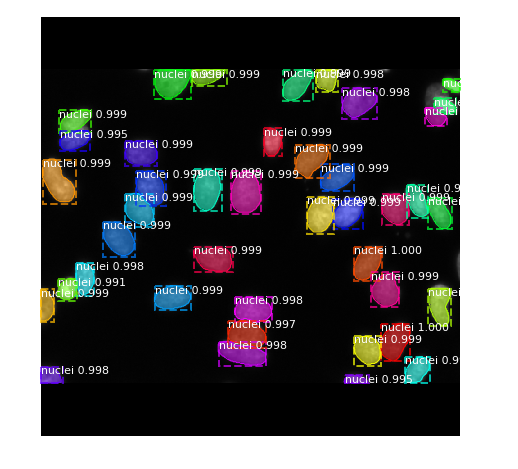

original_image           shape: (512, 512, 3)         min:    0.00000  max:  255.00000
image_meta               shape: (10,)                 min:    0.00000  max: 1388.00000
gt_class_id              shape: (14,)                 min:    1.00000  max:    1.00000
gt_bbox                  shape: (14, 4)               min:    0.00000  max:  512.00000
gt_mask                  shape: (512, 512, 14)        min:    0.00000  max:    1.00000


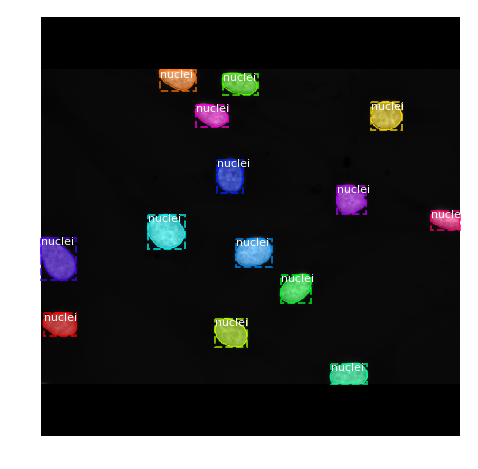

Processing 1 images
image                    shape: (512, 512, 3)         min:    0.00000  max:  255.00000
molded_images            shape: (1, 512, 512, 3)      min:    0.00000  max:  255.00000
image_metas              shape: (1, 10)               min:    0.00000  max:  512.00000


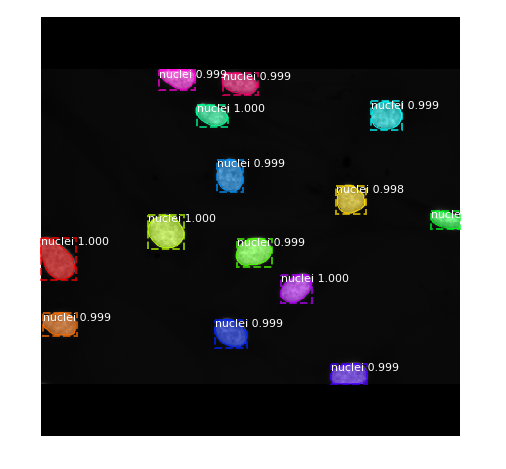

original_image           shape: (512, 512, 3)         min:    0.00000  max:  255.00000
image_meta               shape: (10,)                 min:    0.00000  max:  512.00000
gt_class_id              shape: (29,)                 min:    1.00000  max:    1.00000
gt_bbox                  shape: (29, 4)               min:    0.00000  max:  512.00000
gt_mask                  shape: (512, 512, 29)        min:    0.00000  max:    1.00000


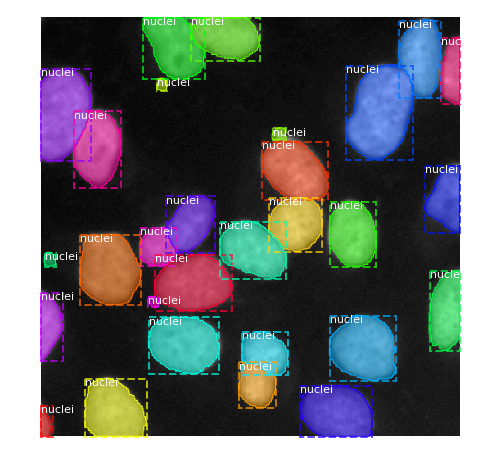

Processing 1 images
image                    shape: (512, 512, 3)         min:    0.00000  max:  255.00000
molded_images            shape: (1, 512, 512, 3)      min:    0.00000  max:  255.00000
image_metas              shape: (1, 10)               min:    0.00000  max:  512.00000


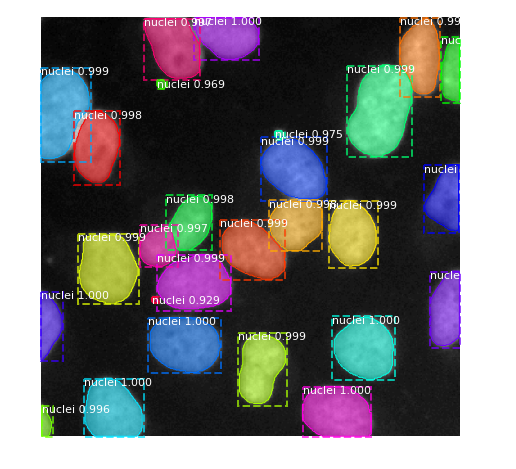

original_image           shape: (512, 512, 3)         min:    5.00000  max:  250.00000
image_meta               shape: (10,)                 min:    0.00000  max:  512.00000
gt_class_id              shape: (17,)                 min:    1.00000  max:    1.00000
gt_bbox                  shape: (17, 4)               min:    0.00000  max:  512.00000
gt_mask                  shape: (512, 512, 17)        min:    0.00000  max:    1.00000


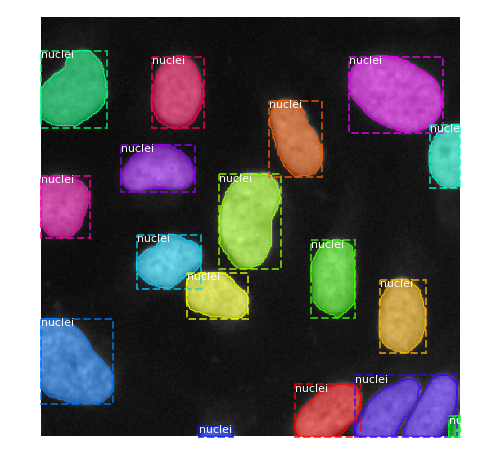

Processing 1 images
image                    shape: (512, 512, 3)         min:    5.00000  max:  250.00000
molded_images            shape: (1, 512, 512, 3)      min:    5.00000  max:  250.00000
image_metas              shape: (1, 10)               min:    0.00000  max:  512.00000


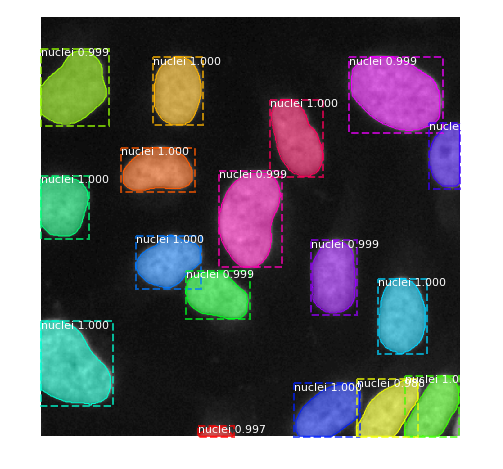

original_image           shape: (512, 512, 3)         min:    1.00000  max:  254.00000
image_meta               shape: (10,)                 min:    0.00000  max:  512.00000
gt_class_id              shape: (33,)                 min:    1.00000  max:    1.00000
gt_bbox                  shape: (33, 4)               min:    0.00000  max:  512.00000
gt_mask                  shape: (512, 512, 33)        min:    0.00000  max:    1.00000


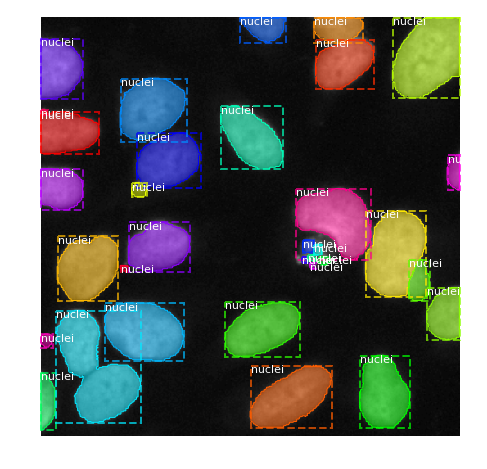

Processing 1 images
image                    shape: (512, 512, 3)         min:    1.00000  max:  254.00000
molded_images            shape: (1, 512, 512, 3)      min:    1.00000  max:  254.00000
image_metas              shape: (1, 10)               min:    0.00000  max:  512.00000


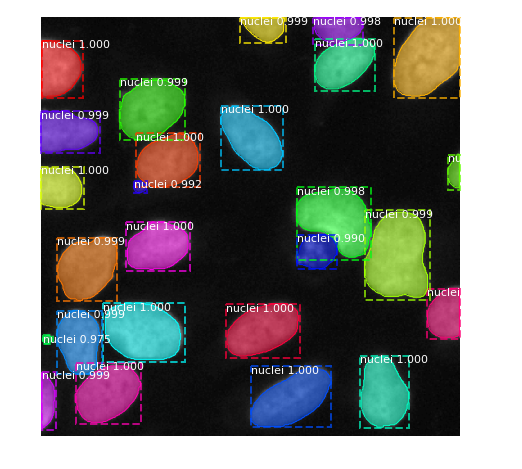

original_image           shape: (512, 512, 3)         min:    0.00000  max:  253.00000
image_meta               shape: (10,)                 min:    0.00000  max:  512.00000
gt_class_id              shape: (23,)                 min:    1.00000  max:    1.00000
gt_bbox                  shape: (23, 4)               min:    0.00000  max:  512.00000
gt_mask                  shape: (512, 512, 23)        min:    0.00000  max:    1.00000


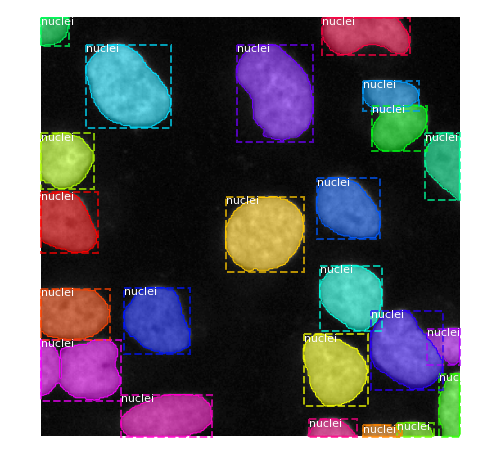

Processing 1 images
image                    shape: (512, 512, 3)         min:    0.00000  max:  253.00000
molded_images            shape: (1, 512, 512, 3)      min:    0.00000  max:  253.00000
image_metas              shape: (1, 10)               min:    0.00000  max:  512.00000


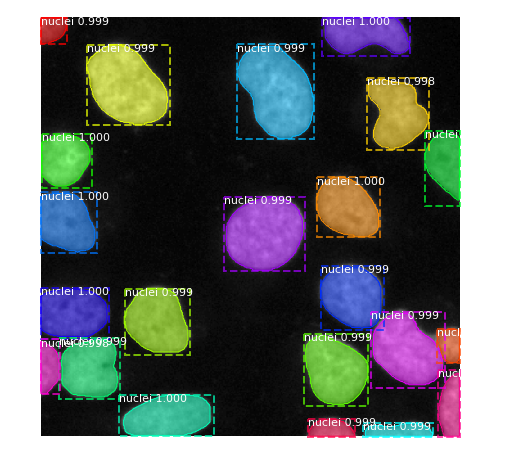

original_image           shape: (512, 512, 3)         min:    0.00000  max:  255.00000
image_meta               shape: (10,)                 min:    0.00000  max:  512.00000
gt_class_id              shape: (42,)                 min:    1.00000  max:    1.00000
gt_bbox                  shape: (42, 4)               min:    0.00000  max:  512.00000
gt_mask                  shape: (512, 512, 42)        min:    0.00000  max:    1.00000


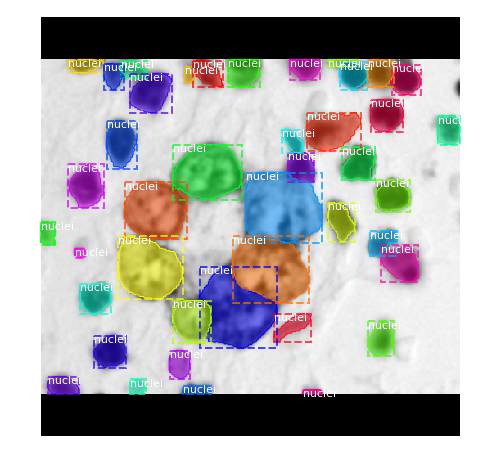

Processing 1 images
image                    shape: (512, 512, 3)         min:    0.00000  max:  255.00000
molded_images            shape: (1, 512, 512, 3)      min:    0.00000  max:  255.00000
image_metas              shape: (1, 10)               min:    0.00000  max:  512.00000


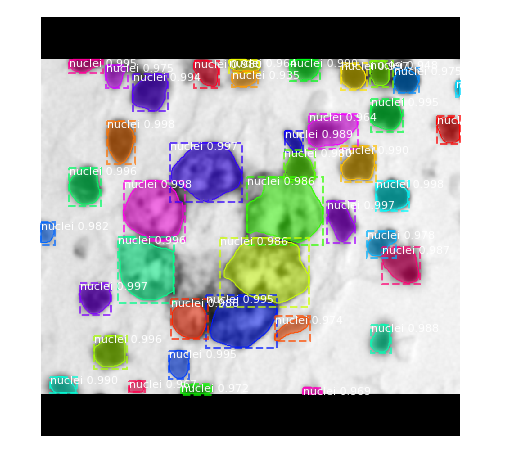

original_image           shape: (512, 512, 3)         min:    0.00000  max:  254.00000
image_meta               shape: (10,)                 min:    0.00000  max:  512.00000
gt_class_id              shape: (25,)                 min:    1.00000  max:    1.00000
gt_bbox                  shape: (25, 4)               min:    0.00000  max:  512.00000
gt_mask                  shape: (512, 512, 25)        min:    0.00000  max:    1.00000


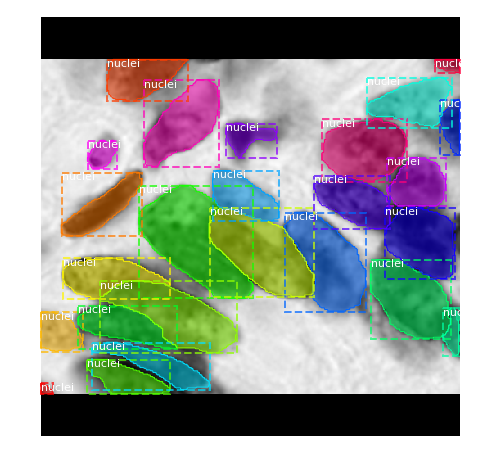

Processing 1 images
image                    shape: (512, 512, 3)         min:    0.00000  max:  254.00000
molded_images            shape: (1, 512, 512, 3)      min:    0.00000  max:  254.00000
image_metas              shape: (1, 10)               min:    0.00000  max:  512.00000


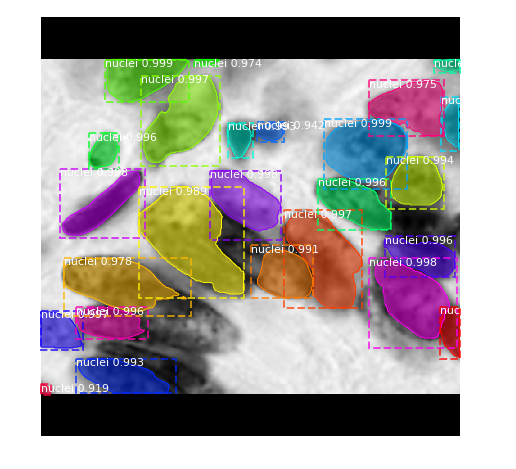

original_image           shape: (512, 512, 3)         min:    0.00000  max:  255.00000
image_meta               shape: (10,)                 min:    0.00000  max:  512.00000
gt_class_id              shape: (49,)                 min:    1.00000  max:    1.00000
gt_bbox                  shape: (49, 4)               min:    0.00000  max:  512.00000
gt_mask                  shape: (512, 512, 49)        min:    0.00000  max:    1.00000


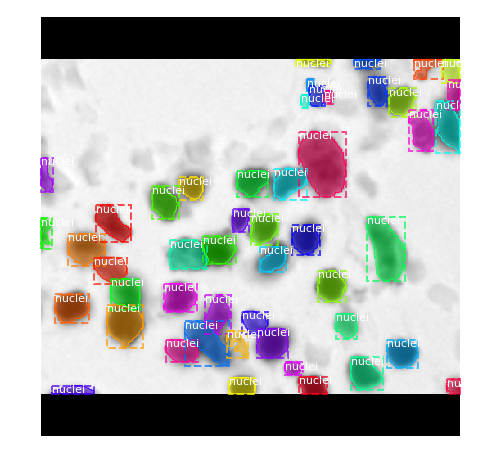

Processing 1 images
image                    shape: (512, 512, 3)         min:    0.00000  max:  255.00000
molded_images            shape: (1, 512, 512, 3)      min:    0.00000  max:  255.00000
image_metas              shape: (1, 10)               min:    0.00000  max:  512.00000


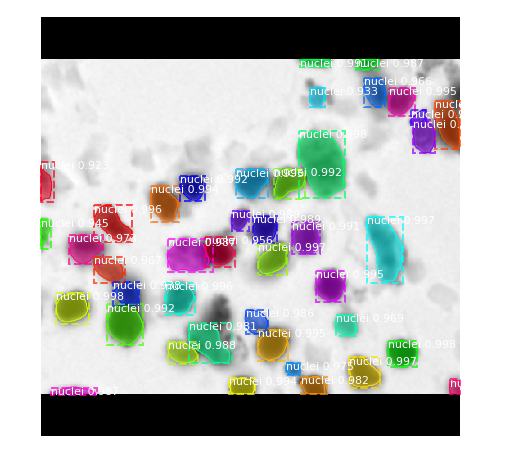

original_image           shape: (512, 512, 3)         min:    0.00000  max:  253.00000
image_meta               shape: (10,)                 min:    0.00000  max:  512.00000
gt_class_id              shape: (14,)                 min:    1.00000  max:    1.00000
gt_bbox                  shape: (14, 4)               min:    0.00000  max:  483.00000
gt_mask                  shape: (512, 512, 14)        min:    0.00000  max:    1.00000


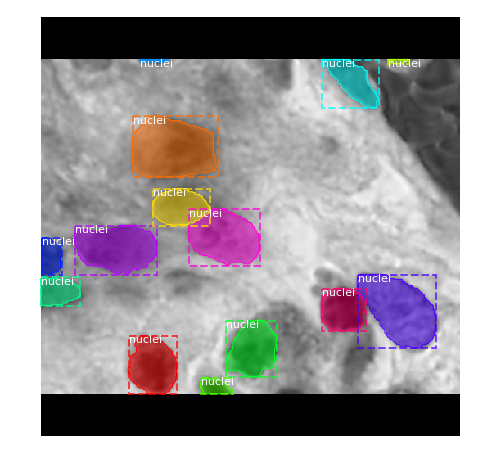

Processing 1 images
image                    shape: (512, 512, 3)         min:    0.00000  max:  253.00000
molded_images            shape: (1, 512, 512, 3)      min:    0.00000  max:  253.00000
image_metas              shape: (1, 10)               min:    0.00000  max:  512.00000


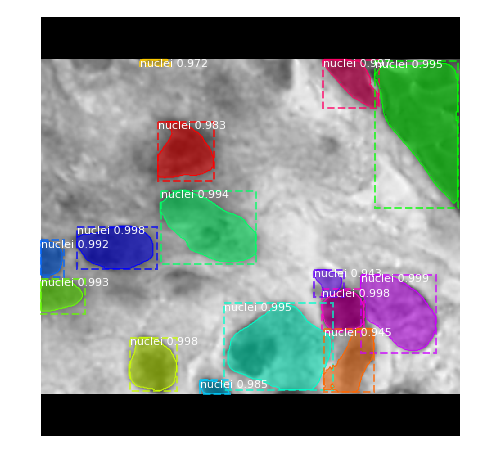

original_image           shape: (512, 512, 3)         min:    0.00000  max:  254.00000
image_meta               shape: (10,)                 min:    0.00000  max:  512.00000
gt_class_id              shape: (15,)                 min:    1.00000  max:    1.00000
gt_bbox                  shape: (15, 4)               min:   30.00000  max:  512.00000
gt_mask                  shape: (512, 512, 15)        min:    0.00000  max:    1.00000


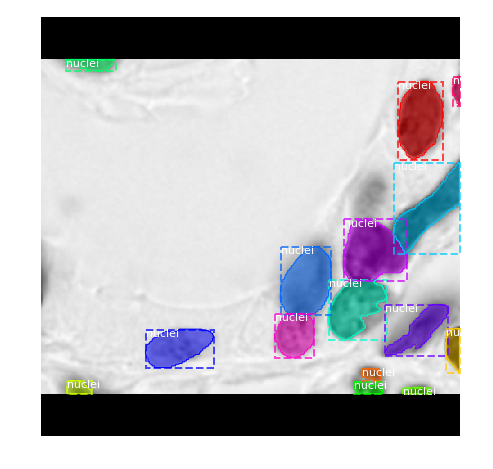

Processing 1 images
image                    shape: (512, 512, 3)         min:    0.00000  max:  254.00000
molded_images            shape: (1, 512, 512, 3)      min:    0.00000  max:  254.00000
image_metas              shape: (1, 10)               min:    0.00000  max:  512.00000


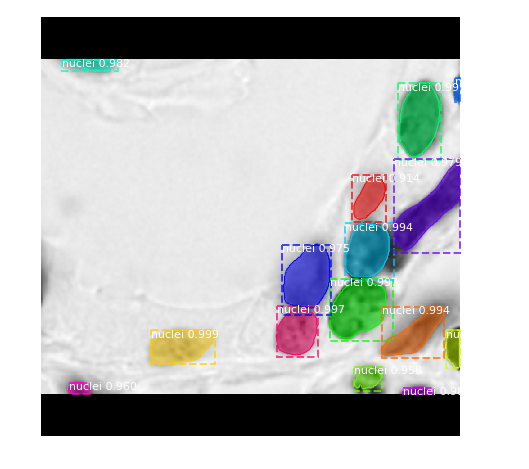

original_image           shape: (512, 512, 3)         min:    0.00000  max:  255.00000
image_meta               shape: (10,)                 min:    0.00000  max:  512.00000
gt_class_id              shape: (26,)                 min:    1.00000  max:    1.00000
gt_bbox                  shape: (26, 4)               min:    0.00000  max:  512.00000
gt_mask                  shape: (512, 512, 26)        min:    0.00000  max:    1.00000


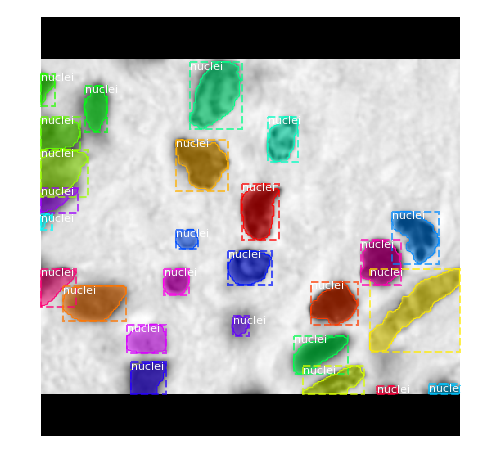

Processing 1 images
image                    shape: (512, 512, 3)         min:    0.00000  max:  255.00000
molded_images            shape: (1, 512, 512, 3)      min:    0.00000  max:  255.00000
image_metas              shape: (1, 10)               min:    0.00000  max:  512.00000


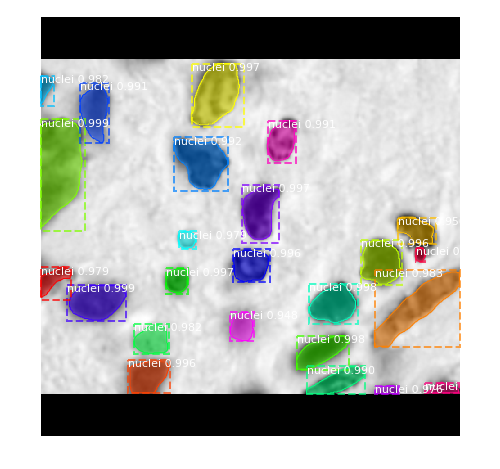

original_image           shape: (512, 512, 3)         min:    0.00000  max:  255.00000
image_meta               shape: (10,)                 min:    0.00000  max:  512.00000
gt_class_id              shape: (59,)                 min:    1.00000  max:    1.00000
gt_bbox                  shape: (59, 4)               min:    0.00000  max:  512.00000
gt_mask                  shape: (512, 512, 59)        min:    0.00000  max:    1.00000


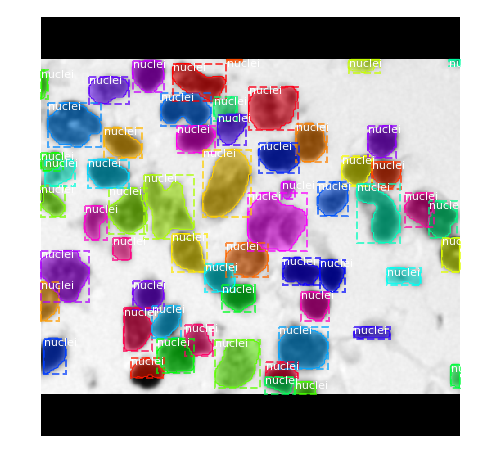

Processing 1 images
image                    shape: (512, 512, 3)         min:    0.00000  max:  255.00000
molded_images            shape: (1, 512, 512, 3)      min:    0.00000  max:  255.00000
image_metas              shape: (1, 10)               min:    0.00000  max:  512.00000


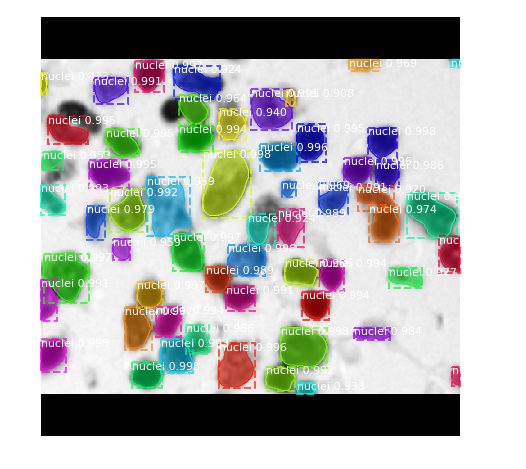

original_image           shape: (512, 512, 3)         min:    0.00000  max:  254.00000
image_meta               shape: (10,)                 min:    0.00000  max:  512.00000
gt_class_id              shape: (64,)                 min:    1.00000  max:    1.00000
gt_bbox                  shape: (64, 4)               min:    0.00000  max:  512.00000
gt_mask                  shape: (512, 512, 64)        min:    0.00000  max:    1.00000


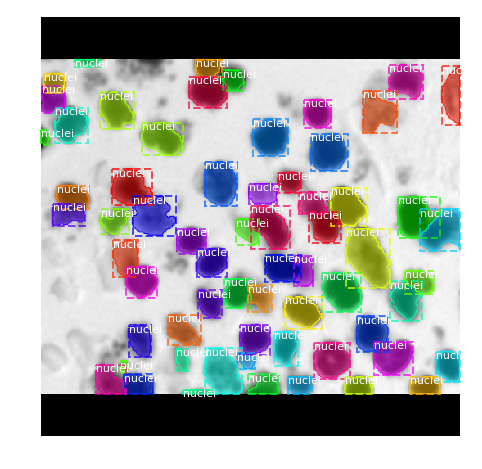

Processing 1 images
image                    shape: (512, 512, 3)         min:    0.00000  max:  254.00000
molded_images            shape: (1, 512, 512, 3)      min:    0.00000  max:  254.00000
image_metas              shape: (1, 10)               min:    0.00000  max:  512.00000


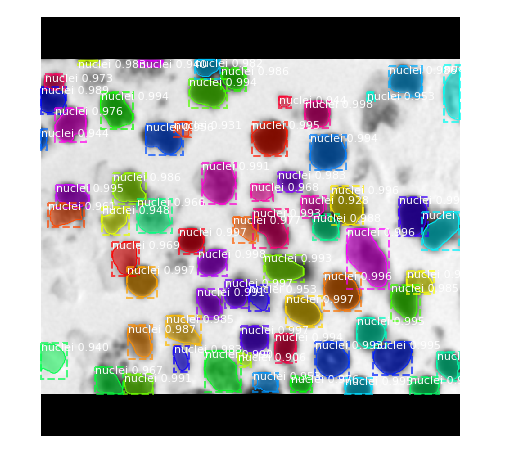

original_image           shape: (512, 512, 3)         min:    0.00000  max:  253.00000
image_meta               shape: (10,)                 min:    0.00000  max:  512.00000
gt_class_id              shape: (23,)                 min:    1.00000  max:    1.00000
gt_bbox                  shape: (23, 4)               min:    0.00000  max:  512.00000
gt_mask                  shape: (512, 512, 23)        min:    0.00000  max:    1.00000


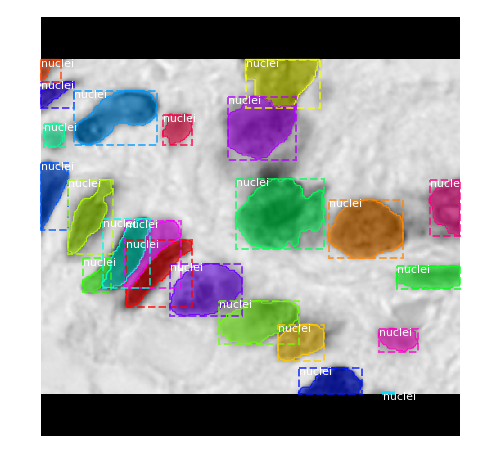

Processing 1 images
image                    shape: (512, 512, 3)         min:    0.00000  max:  253.00000
molded_images            shape: (1, 512, 512, 3)      min:    0.00000  max:  253.00000
image_metas              shape: (1, 10)               min:    0.00000  max:  512.00000


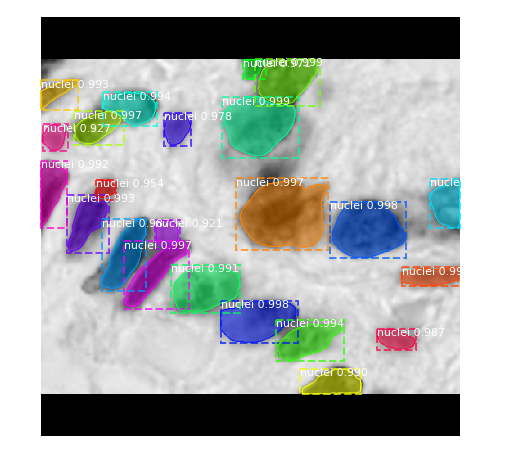

original_image           shape: (512, 512, 3)         min:    1.00000  max:  255.00000
image_meta               shape: (10,)                 min:    0.00000  max:  512.00000
gt_class_id              shape: (12,)                 min:    1.00000  max:    1.00000
gt_bbox                  shape: (12, 4)               min:    0.00000  max:  512.00000
gt_mask                  shape: (512, 512, 12)        min:    0.00000  max:    1.00000


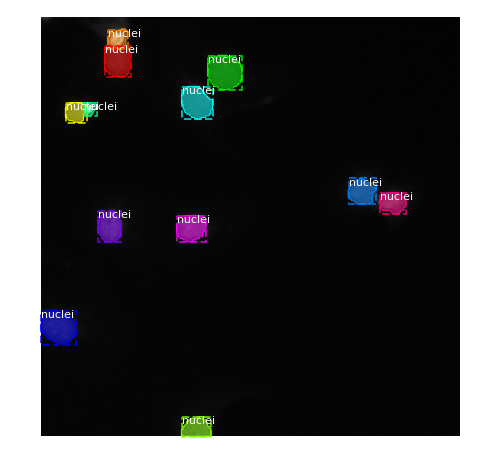

Processing 1 images
image                    shape: (512, 512, 3)         min:    1.00000  max:  255.00000
molded_images            shape: (1, 512, 512, 3)      min:    1.00000  max:  255.00000
image_metas              shape: (1, 10)               min:    0.00000  max:  512.00000


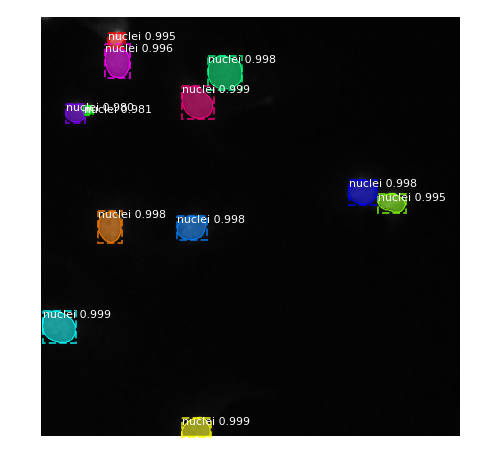

original_image           shape: (512, 512, 3)         min:    1.00000  max:  252.00000
image_meta               shape: (10,)                 min:    0.00000  max:  512.00000
gt_class_id              shape: (10,)                 min:    1.00000  max:    1.00000
gt_bbox                  shape: (10, 4)               min:    0.00000  max:  512.00000
gt_mask                  shape: (512, 512, 10)        min:    0.00000  max:    1.00000


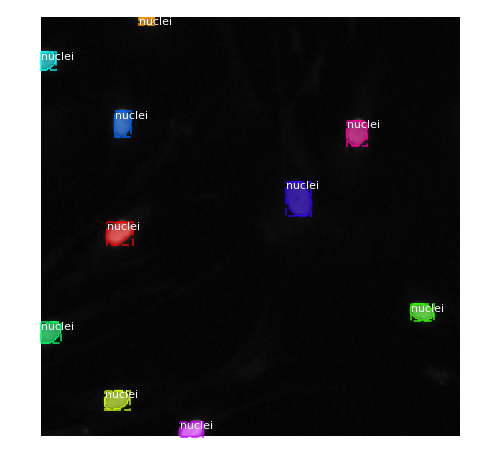

Processing 1 images
image                    shape: (512, 512, 3)         min:    1.00000  max:  252.00000
molded_images            shape: (1, 512, 512, 3)      min:    1.00000  max:  252.00000
image_metas              shape: (1, 10)               min:    0.00000  max:  512.00000


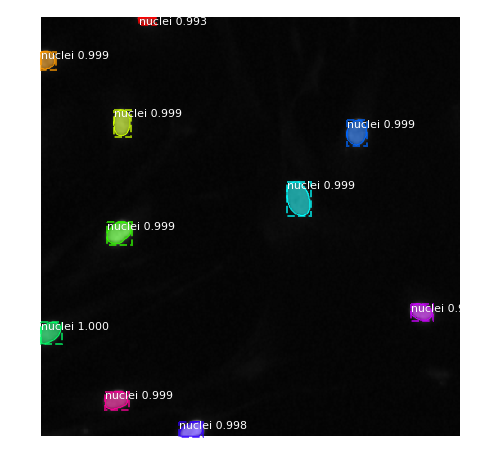

original_image           shape: (512, 512, 3)         min:    1.00000  max:  251.00000
image_meta               shape: (10,)                 min:    0.00000  max:  512.00000
gt_class_id              shape: (19,)                 min:    1.00000  max:    1.00000
gt_bbox                  shape: (19, 4)               min:    0.00000  max:  512.00000
gt_mask                  shape: (512, 512, 19)        min:    0.00000  max:    1.00000


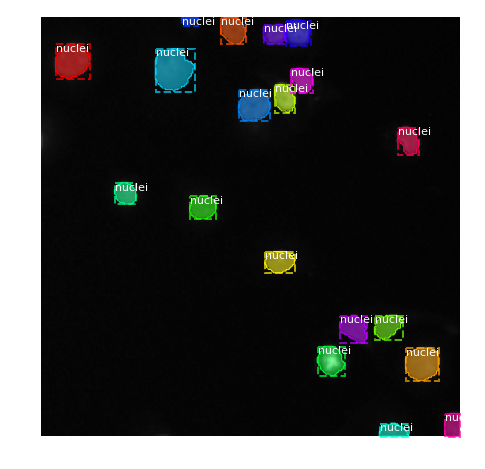

Processing 1 images
image                    shape: (512, 512, 3)         min:    1.00000  max:  251.00000
molded_images            shape: (1, 512, 512, 3)      min:    1.00000  max:  251.00000
image_metas              shape: (1, 10)               min:    0.00000  max:  512.00000


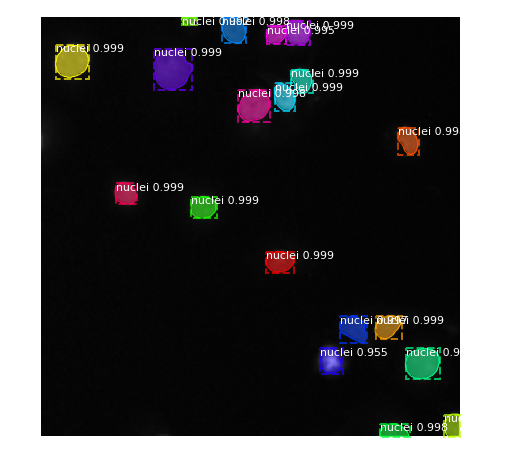

original_image           shape: (512, 512, 3)         min:    1.00000  max:  250.00000
image_meta               shape: (10,)                 min:    0.00000  max:  512.00000
gt_class_id              shape: (7,)                  min:    1.00000  max:    1.00000
gt_bbox                  shape: (7, 4)                min:   34.00000  max:  512.00000
gt_mask                  shape: (512, 512, 7)         min:    0.00000  max:    1.00000


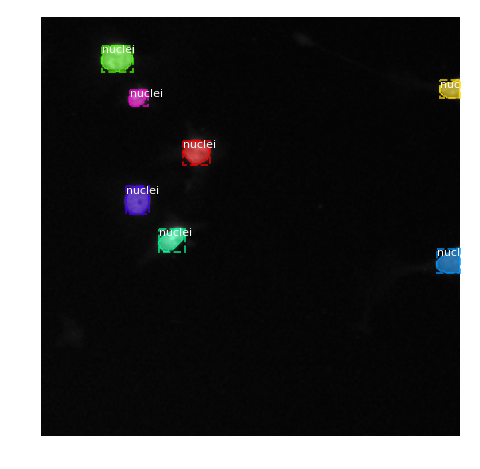

Processing 1 images
image                    shape: (512, 512, 3)         min:    1.00000  max:  250.00000
molded_images            shape: (1, 512, 512, 3)      min:    1.00000  max:  250.00000
image_metas              shape: (1, 10)               min:    0.00000  max:  512.00000


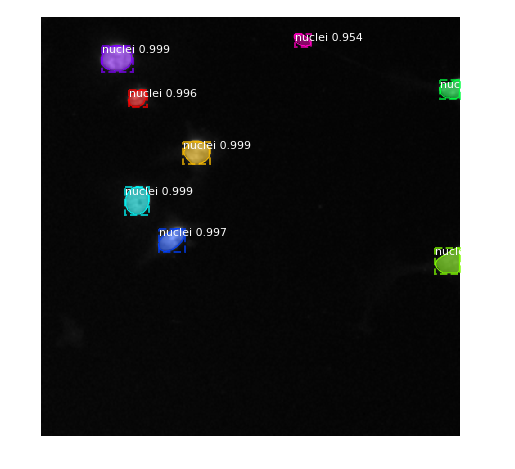

original_image           shape: (512, 512, 3)         min:    1.00000  max:  253.00000
image_meta               shape: (10,)                 min:    0.00000  max:  512.00000
gt_class_id              shape: (20,)                 min:    1.00000  max:    1.00000
gt_bbox                  shape: (20, 4)               min:    0.00000  max:  480.00000
gt_mask                  shape: (512, 512, 20)        min:    0.00000  max:    1.00000


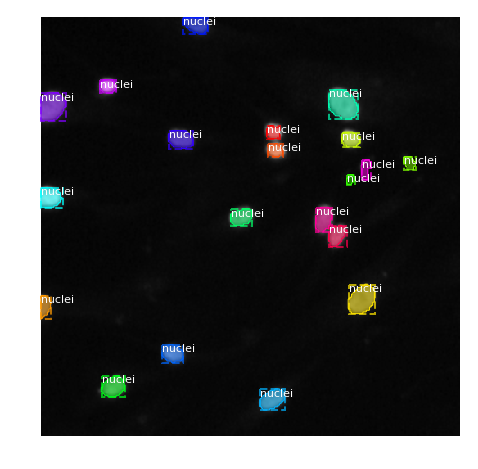

Processing 1 images
image                    shape: (512, 512, 3)         min:    1.00000  max:  253.00000
molded_images            shape: (1, 512, 512, 3)      min:    1.00000  max:  253.00000
image_metas              shape: (1, 10)               min:    0.00000  max:  512.00000


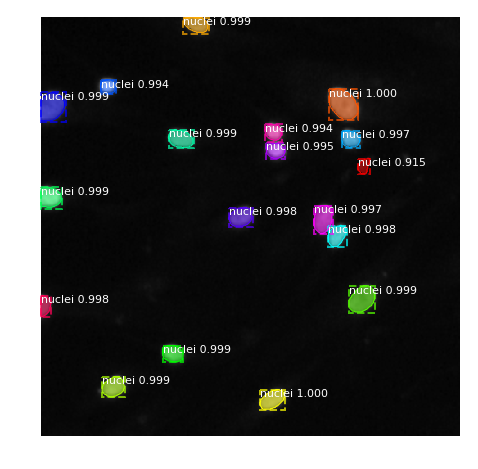

original_image           shape: (512, 512, 3)         min:    0.00000  max:  243.00000
image_meta               shape: (10,)                 min:    0.00000  max:  696.00000
gt_class_id              shape: (8,)                  min:    1.00000  max:    1.00000
gt_bbox                  shape: (8, 4)                min:    0.00000  max:  501.00000
gt_mask                  shape: (512, 512, 8)         min:    0.00000  max:    1.00000


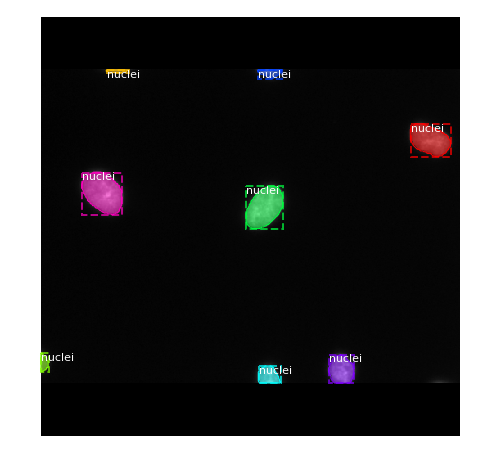

Processing 1 images
image                    shape: (512, 512, 3)         min:    0.00000  max:  243.00000
molded_images            shape: (1, 512, 512, 3)      min:    0.00000  max:  243.00000
image_metas              shape: (1, 10)               min:    0.00000  max:  512.00000


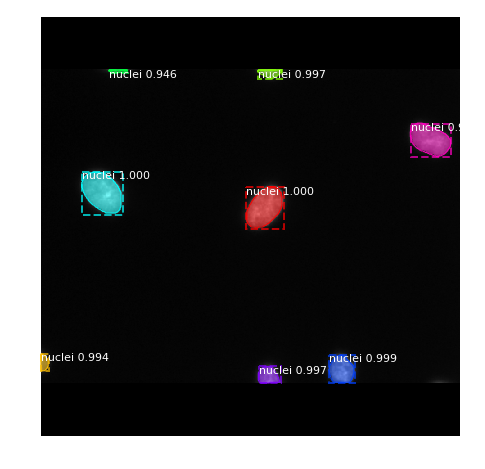

In [43]:
for image_id in dataset_val.image_ids:
    original_image, image_meta, gt_class_id, gt_bbox, gt_mask =\
        modellib.load_image_gt(dataset_val, inference_config, 
                               image_id, use_mini_mask=False)
        
    log("original_image", original_image)
    log("image_meta", image_meta)
    log("gt_class_id", gt_class_id)
    log("gt_bbox", gt_bbox)
    log("gt_mask", gt_mask)

    visualize.display_instances(original_image, gt_bbox, gt_mask, gt_class_id, 
                                dataset_train.class_names, figsize=(8, 8))
    
    results = model.detect([original_image], verbose=1)

    r = results[0]
    visualize.display_instances(original_image, r['rois'], r['masks'], r['class_ids'], 
                                dataset_val.class_names, r['scores'], ax=get_ax())

# Create Submission
It is looking good on the validation.
Let's see how will it do on the public LB.

In [44]:
raw_predictions = []
for test_id in dataset_test.image_ids:
    test_image1 = dataset_test.load_image(test_id, 0)
    pred = model.detect([test_image1], verbose=0)
    pred = pred[0]
    sc = pred['scores']
    pred = pred['masks']
    raw_predictions.append((pred, sc))

In [45]:
def rle_encoding(x):
    '''
    x: numpy array of shape (height, width), 1 - mask, 0 - background
    Returns run length as list
    '''
    dots = np.where(x.T.flatten()==1)[0] # .T sets Fortran order down-then-right
    run_lengths = []
    prev = -2
    for b in dots:
        if (b>prev+1): run_lengths.extend((b+1, 0))
        run_lengths[-1] += 1
        prev = b
    return run_lengths

In [46]:
def numpy2encoding_no_overlap(predicts, img_name, scores):
    sum_predicts = np.sum(predicts, axis=2)
    rows, cols = np.where(sum_predicts>=2)
    
    for i in zip(rows, cols):
        instance_indicies = np.where(np.any(predicts[i[0],i[1],:]))[0]
        highest = instance_indicies[0]
        predicts[i[0],i[1],:] = predicts[i[0],i[1],:]*0
        predicts[i[0],i[1],highest] = 1
    
    ImageId = []
    EncodedPixels = []
    print(predicts.shape)
    for i in range(predicts.shape[2]): 
        rle = rle_encoding(predicts[:,:,i])
        if len(rle)>0:
            ImageId.append(img_name)
            EncodedPixels.append(rle)    
    return ImageId, EncodedPixels

In [47]:
new_test_ids = []
rles = []
for id, raw_pred in zip(test_ids, raw_predictions):
    ids, rle = numpy2encoding_no_overlap(raw_pred[0], id, raw_pred[1])
    new_test_ids += ids
    rles += rle

(256, 256, 6)
(512, 680, 14)
(390, 239, 14)
(260, 347, 103)
(512, 680, 21)
(524, 348, 77)
(260, 347, 84)
(519, 161, 36)
(256, 256, 12)
(512, 680, 13)
(512, 640, 4)
(256, 256, 10)
(512, 640, 4)
(256, 256, 45)
(256, 256, 7)
(524, 348, 61)
(519, 253, 54)
(256, 256, 53)
(256, 256, 73)
(256, 256, 14)
(256, 256, 9)
(512, 680, 39)
(520, 696, 25)
(256, 256, 34)
(519, 162, 41)
(524, 348, 78)
(520, 696, 25)
(520, 348, 172)
(256, 256, 28)
(256, 256, 10)
(512, 680, 50)
(256, 256, 7)
(512, 640, 19)
(260, 347, 106)
(512, 680, 24)
(512, 640, 17)
(519, 253, 55)
(256, 256, 42)
(256, 256, 4)
(520, 348, 164)
(520, 348, 185)
(520, 348, 196)
(512, 640, 14)
(256, 256, 5)
(524, 348, 57)
(512, 640, 3)
(512, 680, 54)
(520, 696, 24)
(512, 680, 46)
(256, 256, 13)
(256, 256, 8)
(519, 253, 53)
(256, 256, 14)
(519, 161, 46)
(256, 256, 29)
(519, 162, 39)
(256, 256, 11)
(519, 253, 57)
(512, 640, 19)
(256, 256, 10)
(260, 347, 100)
(520, 696, 30)
(256, 256, 10)
(512, 640, 19)
(256, 256, 80)


In [48]:
df = pd.DataFrame({ 'ImageId' : new_test_ids , 'EncodedPixels' : rles})
df.to_csv('output/submission.csv', index=False, columns=['ImageId', 'EncodedPixels'])

This should get you to around 0.44 on the LB. 

Tweak it and improve your score!